** Merging 2 images **

In this notebook, 2 imags are merged together by training a SIREN model to produce an image which gradient will be the average of the 2 gradients of the initial images. 

This operation is computationnally expensive, hence:

- the images are set to 128*128
- the gradient is limited to horizontal gradient

The images are RGB, and so is the output. We obtain a correct output. 

In [1]:
import torch
from torch import nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import os

from PIL import Image
from torchvision.transforms import Resize, Compose, ToTensor, Normalize, Grayscale
import numpy as np
import skimage
import matplotlib.pyplot as plt
import random

import urllib.request
import time

def get_mgrid(sidelen, dim=2, depth=1):
    '''Generates a flattened grid of (x,y,...) coordinates in a range of -1 to 1.
    sidelen: int
    dim: int'''
    tensors = tuple(dim * [torch.linspace(-1, 1, steps=sidelen)])+(torch.linspace(-1, 1, steps=depth),)
    print(tensors[0].size(), tensors[1].size(), tensors[2].size())
    print(len(torch.meshgrid(*tensors)))
    mgrid = torch.stack(torch.meshgrid(*tensors), dim=-1)
    print("Mgrid step 2: ", mgrid.size())
    mgrid = mgrid.reshape(depth, sidelen**2, dim+1)
    print("Mgrid step 3: ", mgrid.size())
    return mgrid

In [2]:
nb_images=1
sidelength=128
get_mgrid(sidelength, 2, depth=nb_images)

torch.Size([128]) torch.Size([128]) torch.Size([1])
3
Mgrid step 2:  torch.Size([128, 128, 1, 3])
Mgrid step 3:  torch.Size([1, 16384, 3])


tensor([[[-1.0000, -1.0000, -1.0000],
         [-1.0000, -0.9843, -1.0000],
         [-1.0000, -0.9685, -1.0000],
         ...,
         [ 1.0000,  0.9685, -1.0000],
         [ 1.0000,  0.9843, -1.0000],
         [ 1.0000,  1.0000, -1.0000]]])

Definition of the gradient: only the horizontal gradient is taken into account

The laplacian will not be used.

In [3]:
def laplace(y, x):
    grad = gradient(y, x)
    return divergence(grad, x)


def divergence(y, x):
    div = 0.
    for i in range(y.shape[-1]):
        div += torch.autograd.grad(y[..., i], x, torch.ones_like(y[..., i]), create_graph=True)[0][..., i:i+1]
    return div


def gradient(y, x, grad_outputs=None):
    """
    if grad_outputs is None:
        grad_outputs = torch.ones_like(y)
    grad = torch.autograd.grad(y, [x], grad_outputs=grad_outputs, create_graph=True)[0]
    """
    grad=torch.ones_like(y)
    (_, l1, l2, l3)=grad.size()
    for i in range(1, l2-1):
      for j in range(3):
        grad[0, 0, i, j]=(y[0, 0, i+1, j] - y[0, 0, i-1, j])/2
    for j in range(3):
      grad[0, 0, 0, j]=(y[0, 0, 1, j] - y[0, 0, 0, j])
      grad[0, 0, l2-1, j]=(y[0, 0, l2-1, j] - y[0, 0, l2-2, j])
    return grad

Definition of the SIREN model, with 3 outputs for the RGB channels

In [4]:
class SineLayer(nn.Module):
    # See paper sec. 3.2, final paragraph, and supplement Sec. 1.5 for discussion of omega_0.
    
    # If is_first=True, omega_0 is a frequency factor which simply multiplies the activations before the 
    # nonlinearity. Different signals may require different omega_0 in the first layer - this is a 
    # hyperparameter.
    
    # If is_first=False, then the weights will be divided by omega_0 so as to keep the magnitude of 
    # activations constant, but boost gradients to the weight matrix (see supplement Sec. 1.5)
    
    def __init__(self, in_features, out_features, bias=True,
                 is_first=False, omega_0=30):
        super().__init__()
        self.omega_0 = omega_0
        self.is_first = is_first
        
        self.in_features = in_features
        self.linear = nn.Linear(in_features, out_features, bias=bias)
        
        self.init_weights()
    
    def init_weights(self):
        with torch.no_grad():
            if self.is_first:
                self.linear.weight.uniform_(-1 / self.in_features, 
                                             1 / self.in_features)      
            else:
                self.linear.weight.uniform_(-np.sqrt(6 / self.in_features) / self.omega_0, 
                                             np.sqrt(6 / self.in_features) / self.omega_0)
        
    def forward(self, input):
        return torch.sin(self.omega_0 * self.linear(input))
    
    def forward_with_intermediate(self, input): 
        # For visualization of activation distributions
        intermediate = self.omega_0 * self.linear(input)
        return torch.sin(intermediate), intermediate
    
    
class Siren(nn.Module):
    def __init__(self, in_features, hidden_features, hidden_layers, out_features, outermost_linear=False, 
                 first_omega_0=30, hidden_omega_0=30.):
        super().__init__()
        
        self.net = []
        self.net.append(SineLayer(in_features, hidden_features, 
                                  is_first=True, omega_0=first_omega_0))

        for i in range(hidden_layers):
            self.net.append(SineLayer(hidden_features, hidden_features, 
                                      is_first=False, omega_0=hidden_omega_0))

        if outermost_linear:
            final_linear = nn.Linear(hidden_features, out_features)
            
            with torch.no_grad():
                final_linear.weight.uniform_(-np.sqrt(6 / hidden_features) / hidden_omega_0, 
                                              np.sqrt(6 / hidden_features) / hidden_omega_0)
                
            self.net.append(final_linear)
        else:
            self.net.append(SineLayer(hidden_features, out_features, 
                                      is_first=False, omega_0=hidden_omega_0))
        
        self.net = nn.Sequential(*self.net)
    
    def forward(self, coords):
        coords = coords.clone().detach().requires_grad_(True) # allows to take derivative w.r.t. input
        output = self.net(coords)
        #output=gradient(output, coords)
        return output, coords        

    def forward_with_activations(self, coords, retain_grad=False):
        '''Returns not only model output, but also intermediate activations.
        Only used for visualizing activations later!'''
        activations = OrderedDict()

        activation_count = 0
        x = coords.clone().detach().requires_grad_(True)
        activations['input'] = x
        for i, layer in enumerate(self.net):
            if isinstance(layer, SineLayer):
                x, intermed = layer.forward_with_intermediate(x)
                
                if retain_grad:
                    x.retain_grad()
                    intermed.retain_grad()
                    
                activations['_'.join((str(layer.__class__), "%d" % activation_count))] = intermed
                activation_count += 1
            else: 
                x = layer(x)
                
                if retain_grad:
                    x.retain_grad()
                    
            activations['_'.join((str(layer.__class__), "%d" % activation_count))] = x
            activation_count += 1

        return activations

In [5]:
!ls

imageA.jpg  imageB.jpg	sample_data


In [6]:
image_url="https://kcrwberlin.com/wp-content/uploads/2019/06/cargo-ship-sea-ship-1036865-1024x574.jpg"
filename = 'imageA.jpg'
urllib.request.urlretrieve(image_url, filename)
image_url="http://www.oiseaux-birds.com/procellariiformes/diomedeides/albatros-laysan/albatros-laysan-vol-op.jpg"
filename = 'imageB.jpg'
urllib.request.urlretrieve(image_url, filename)

('imageB.jpg', <http.client.HTTPMessage at 0x7f5bedaf0438>)

In [7]:
!ls


imageA.jpg  imageB.jpg	sample_data


In [8]:
def get_images_pair(sidelength=128):
    imgA = Image.fromarray(np.array(Image.open("imageA.jpg")))
    imgB=Image.fromarray(np.array(Image.open("imageB.jpg")))
    transform = Compose([
        Resize((sidelength, sidelength)),
        ToTensor(),
        #Normalize(torch.Tensor([0.5]), torch.Tensor([0.5]))
    ])
    imgA = transform(imgA)
    imgB = transform(imgB)
    imgA=imgA.permute(1, 2, 0)
    imgB=imgB.permute(1, 2, 0)
    return imgA, imgB


torch.Size([128, 128, 3])


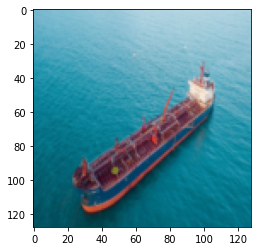

In [9]:

imgA, imgB=get_images_pair()
print(imgA.shape)
plt.imshow(imgA)
#plt.imshow(imgB)

In [10]:
def get_cameraman_tensor(sidelength):
    img = Image.fromarray(skimage.data.camera())        
    transform = Compose([
        Resize(sidelength),
        ToTensor(),
        Normalize(torch.Tensor([0.5]), torch.Tensor([0.5]))
    ])
    img = transform(img)
    return img

def get_astronaut_tensor(sidelength):
    img = Image.fromarray(skimage.data.astronaut())        
    transform = Compose([
        Resize(sidelength),
        Grayscale(num_output_channels=1),
        ToTensor(),
        Normalize(torch.Tensor([0.5]), torch.Tensor([0.5]))
    ])
    img = transform(img)
    return img

In [11]:
class ImageFitting1(Dataset):
    def __init__(self, sidelength, img_input, nb_images=2):
        super().__init__()
        img = img_input.reshape(sidelength**2, 3)
        print("Pixels size: ", img.size())
        self.pixels = img
        self.coords = get_mgrid(sidelength, 2, depth=nb_images)
        print("Coords size: ", self.coords.size())

    def __len__(self):
        return 1

    def __getitem__(self, idx):    
        if idx > len(self.pixels): raise IndexError
            
        return self.coords, self.pixels

In [12]:
sidelength=128
imgA, imgB=get_images_pair(sidelength=sidelength)

Training one model to store image 1: step not necessary in merging

In [13]:
size_img=128
nb_images=1
img1 = ImageFitting1(size_img, imgA, nb_images=nb_images)
dataloader1 = DataLoader(img1, batch_size=1, pin_memory=True, num_workers=0)

img_siren = Siren(in_features=3, out_features=3, hidden_features=256, 
                  hidden_layers=3, outermost_linear=True)
img_siren.cuda()

Pixels size:  torch.Size([16384, 3])
torch.Size([128]) torch.Size([128]) torch.Size([1])
3
Mgrid step 2:  torch.Size([128, 128, 1, 3])
Mgrid step 3:  torch.Size([1, 16384, 3])
Coords size:  torch.Size([1, 16384, 3])


Siren(
  (net): Sequential(
    (0): SineLayer(
      (linear): Linear(in_features=3, out_features=256, bias=True)
    )
    (1): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (2): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (3): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (4): Linear(in_features=256, out_features=3, bias=True)
  )
)

We train a model to produce image 1, so that we have the gradient of image 1

/usr/local/lib/python3.6/dist-packages/torch/tensor.py:447: UserWarning: non-inplace resize is deprecated
  warnings.warn("non-inplace resize is deprecated")


Input, output sizes;  torch.Size([1, 1, 16384, 3]) torch.Size([1, 1, 16384, 3])
Model_input:  tensor([[[[-1.0000, -1.0000, -1.0000],
          [-1.0000, -0.9843, -1.0000],
          [-1.0000, -0.9685, -1.0000],
          ...,
          [ 1.0000,  0.9685, -1.0000],
          [ 1.0000,  0.9843, -1.0000],
          [ 1.0000,  1.0000, -1.0000]]]], device='cuda:0')
Output size:  torch.Size([1, 1, 16384, 3])
Step 0, Total loss 0.272457


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


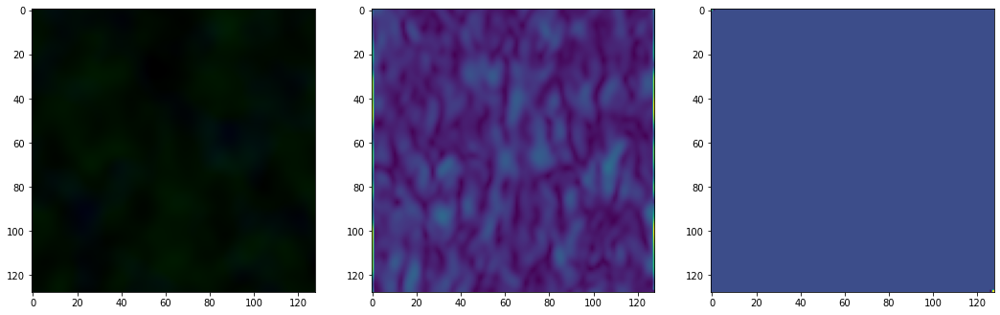

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 10, Total loss 0.037730


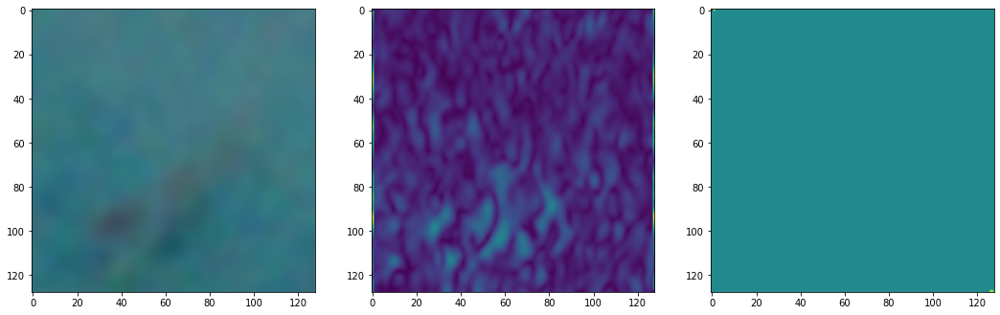

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 20, Total loss 0.009561


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


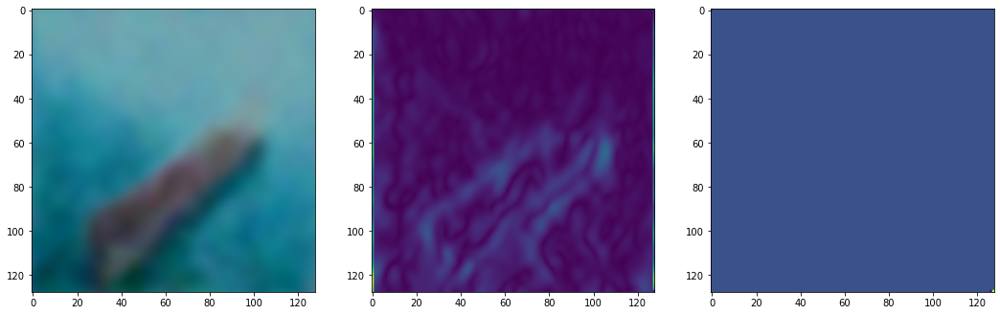

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 30, Total loss 0.003700


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


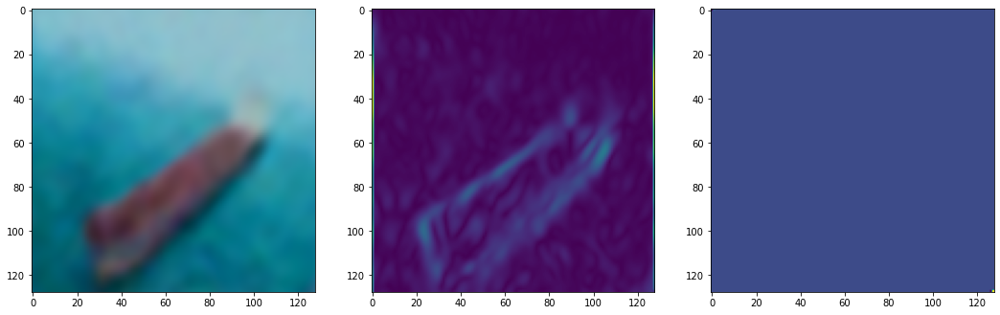

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 40, Total loss 0.002643


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


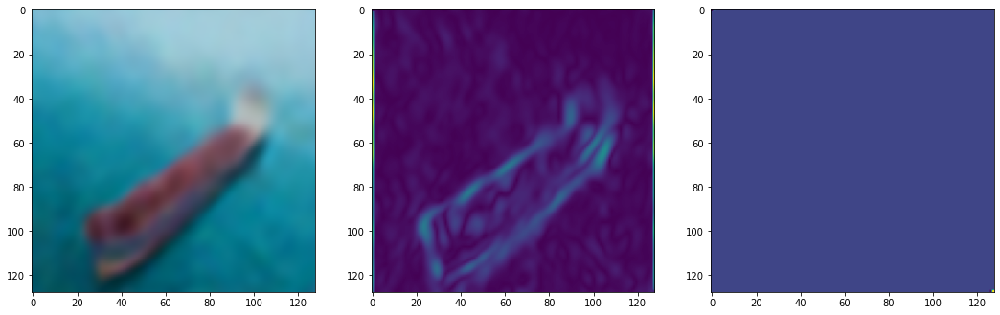

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 50, Total loss 0.002236


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


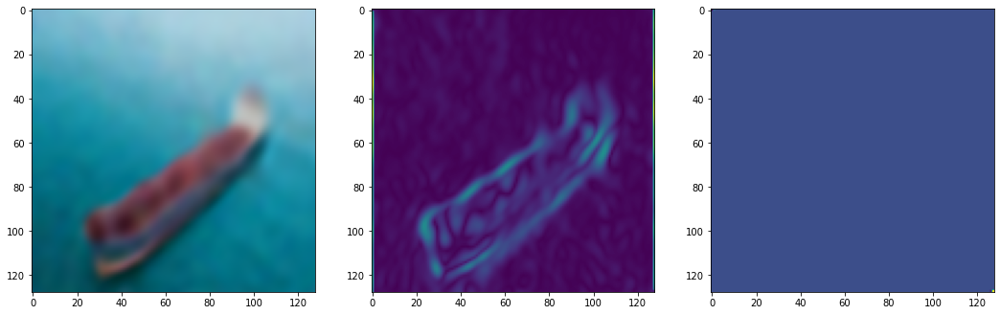

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 60, Total loss 0.001985


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


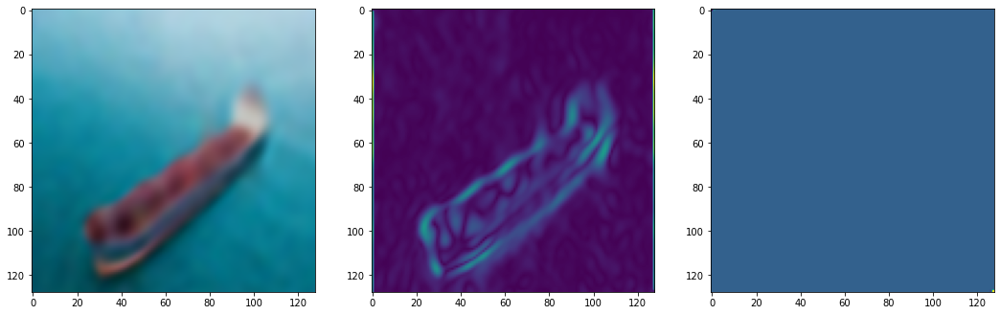

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 70, Total loss 0.001803


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


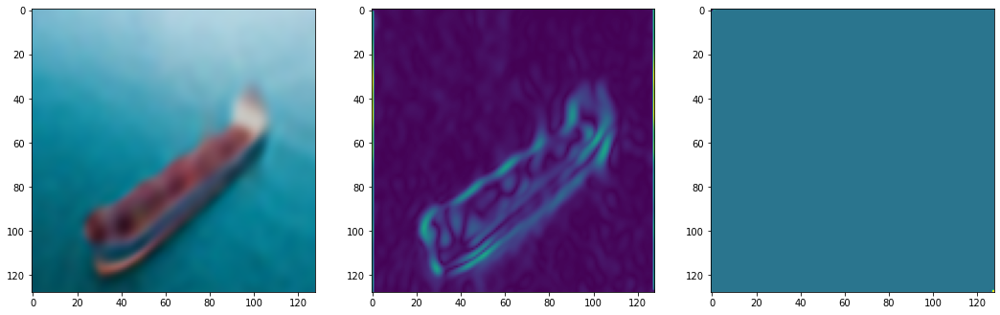

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 80, Total loss 0.001657


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


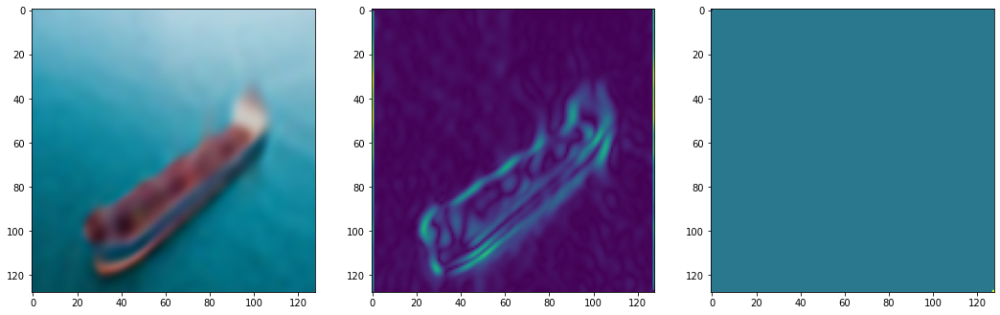

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 90, Total loss 0.001533


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


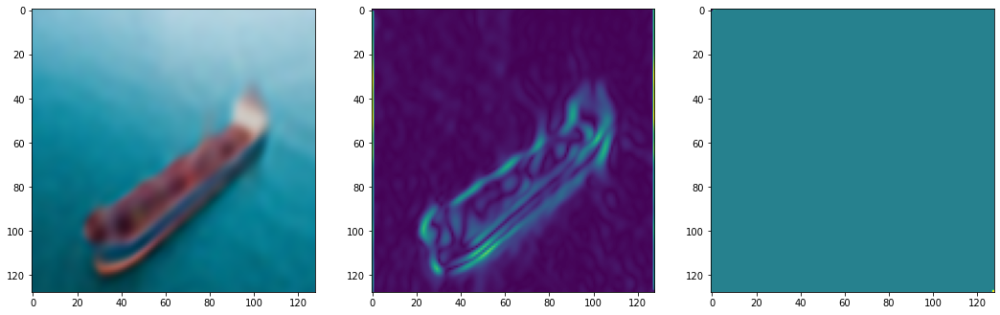

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 100, Total loss 0.001425


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


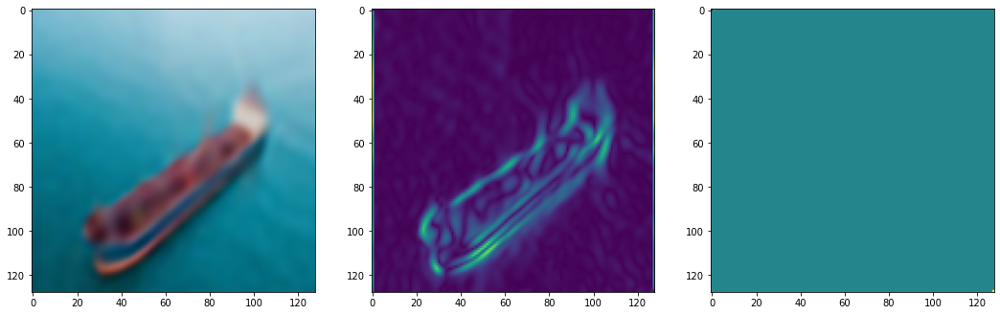

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 110, Total loss 0.001331


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


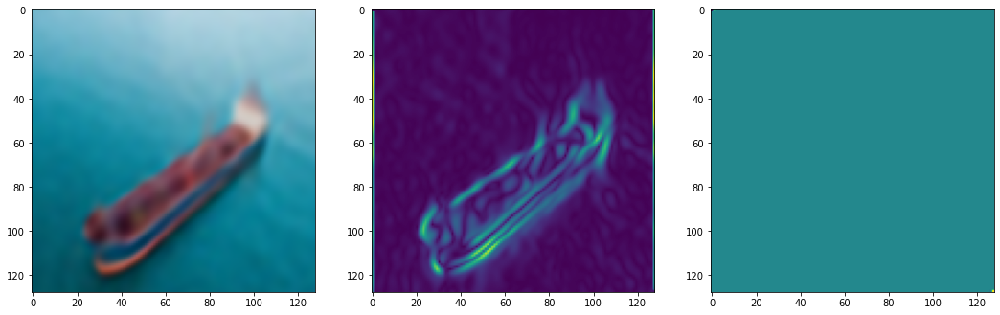

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 120, Total loss 0.001248


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


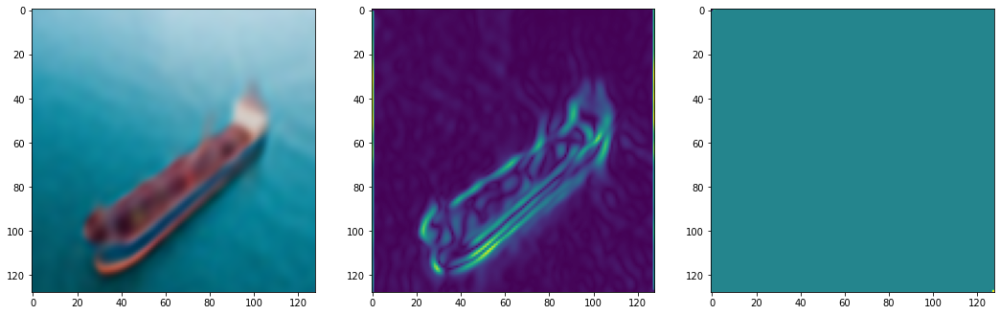

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 130, Total loss 0.001175


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


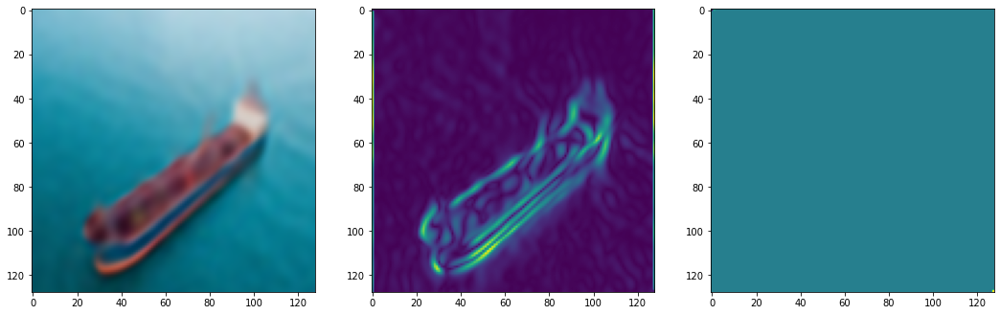

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 140, Total loss 0.001111


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


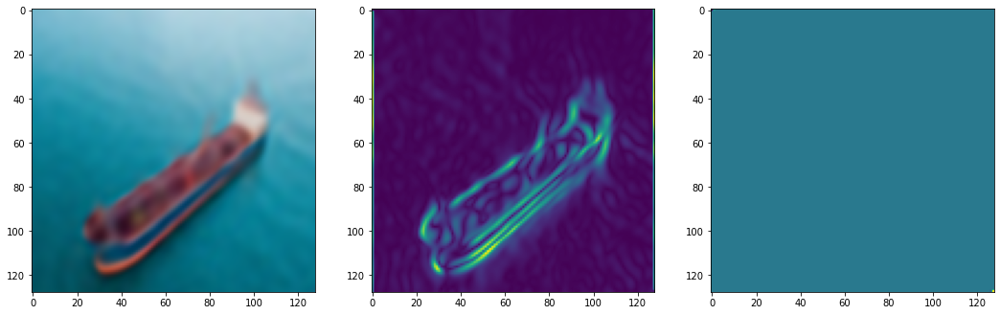

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 150, Total loss 0.001056


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


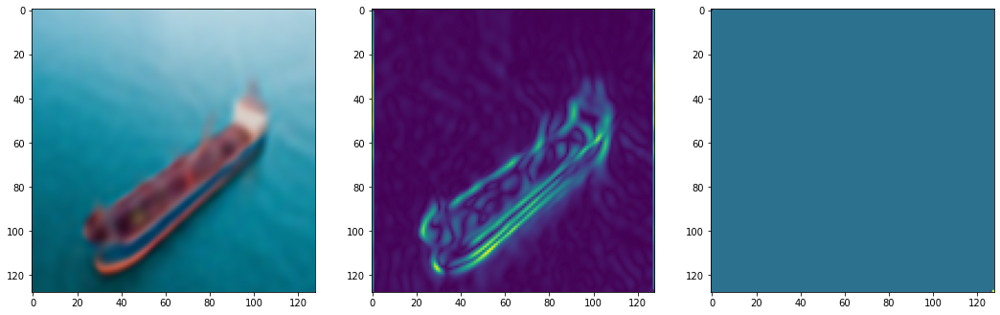

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 160, Total loss 0.001008


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


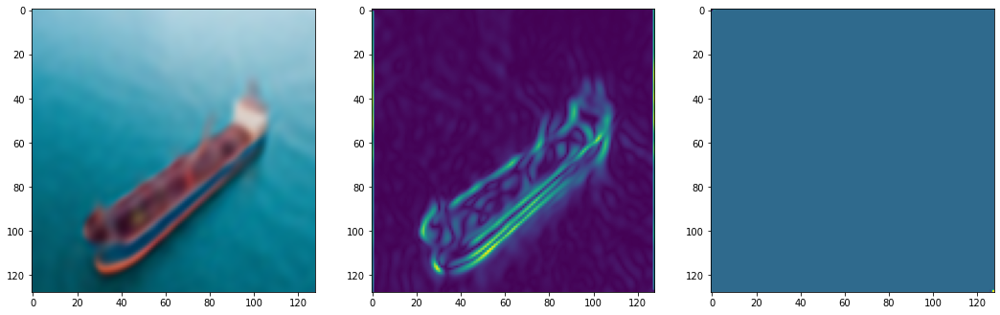

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 170, Total loss 0.000965


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


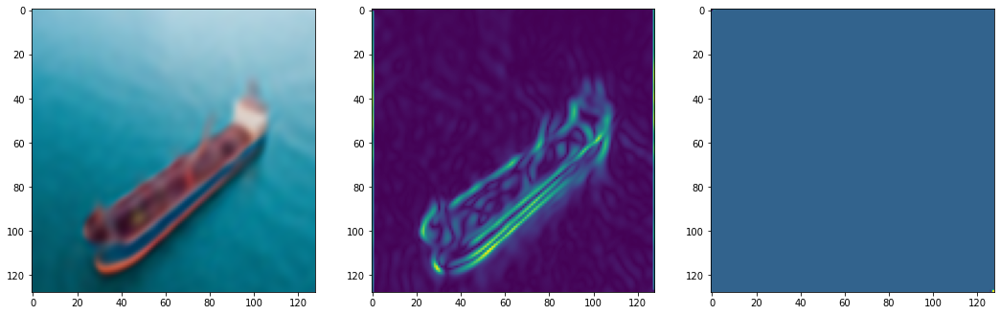

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 180, Total loss 0.000928


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


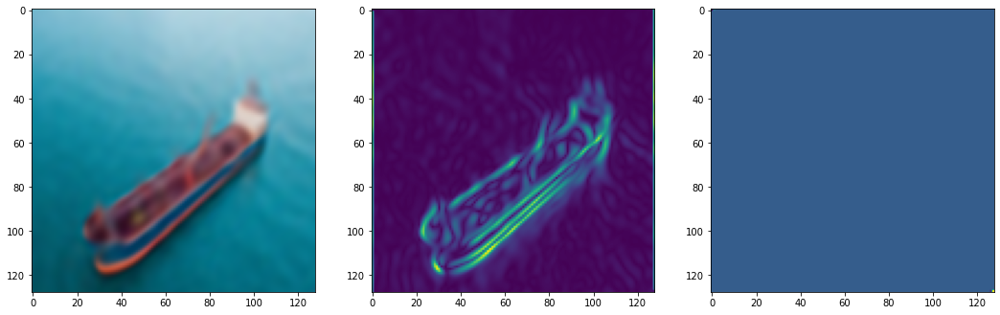

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 190, Total loss 0.000894


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


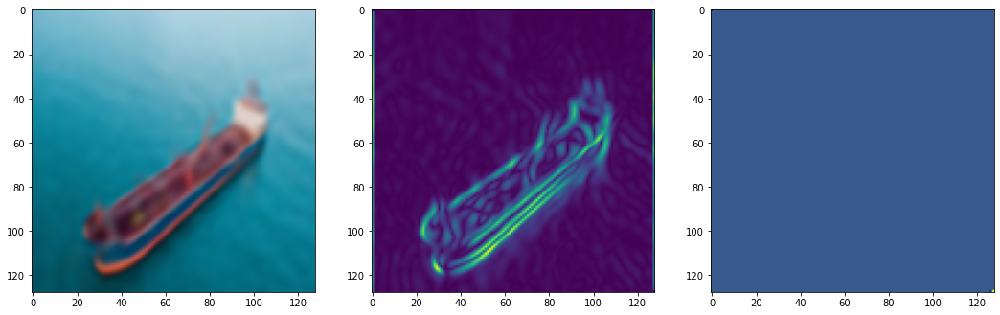

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 200, Total loss 0.000864


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


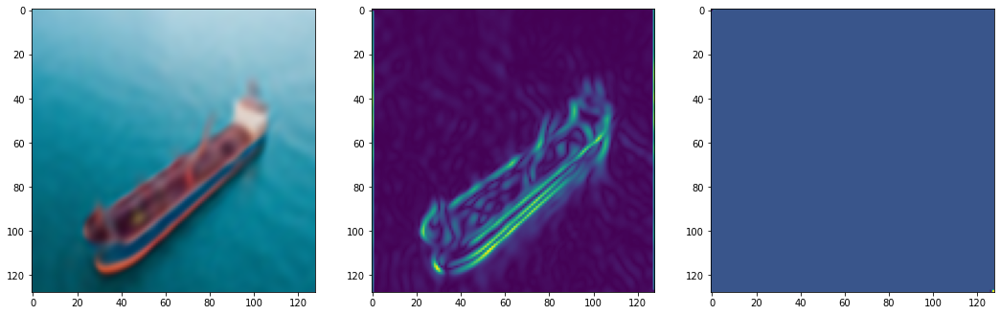

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 210, Total loss 0.000836


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


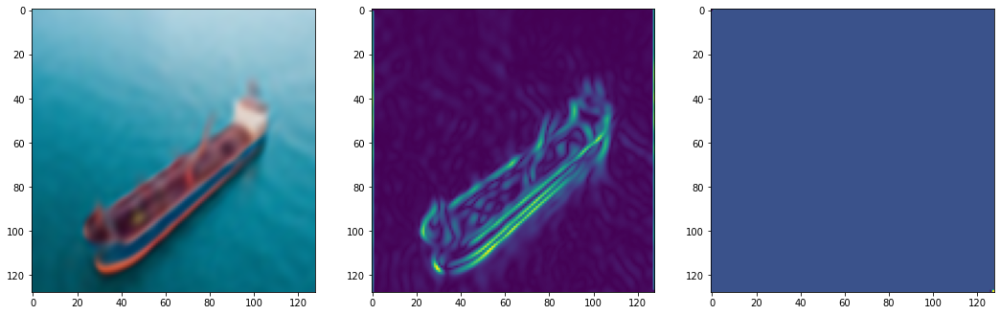

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 220, Total loss 0.000810


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


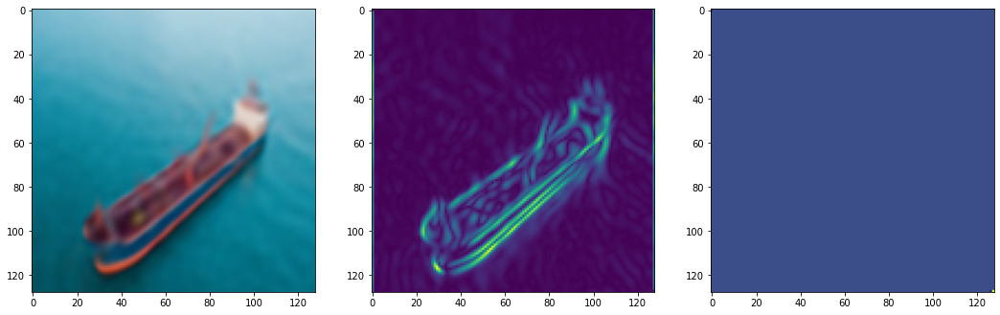

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 230, Total loss 0.000786


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


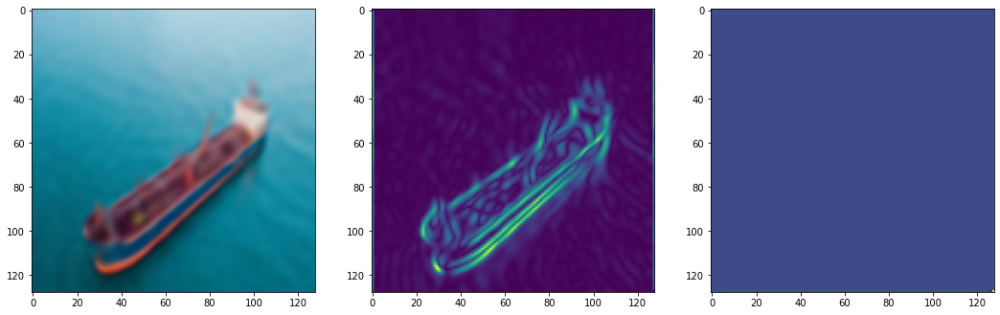

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 240, Total loss 0.000764


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


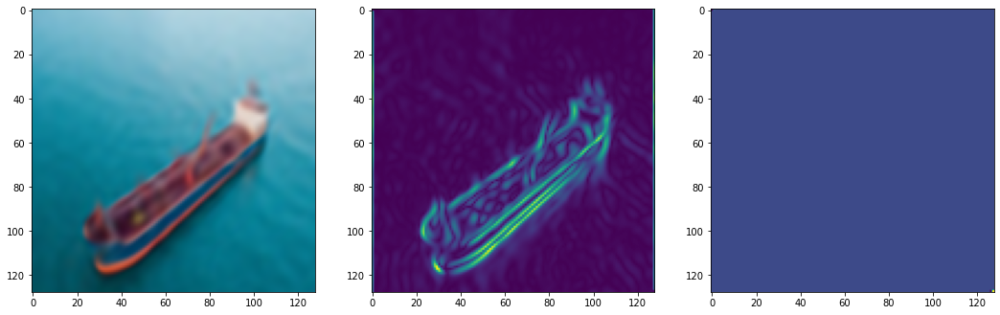

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 250, Total loss 0.000744


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


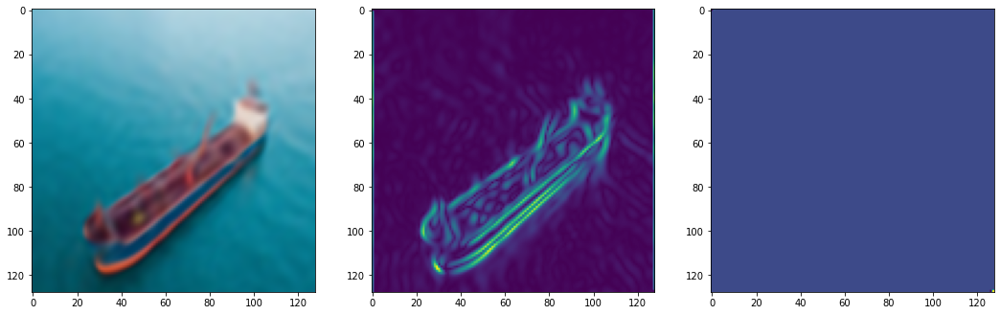

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 260, Total loss 0.000724


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


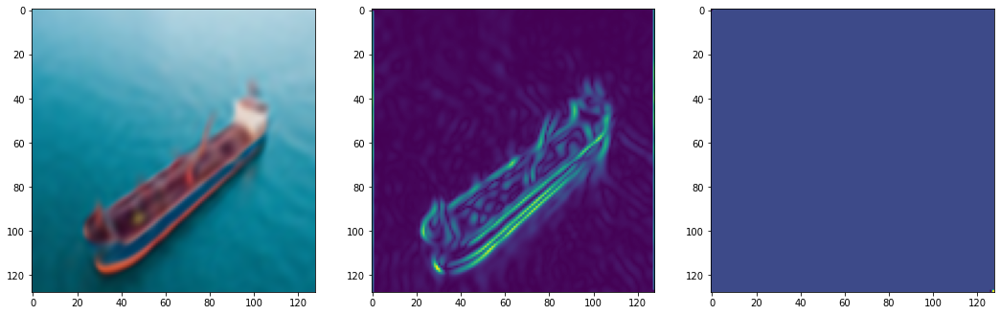

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 270, Total loss 0.000707


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


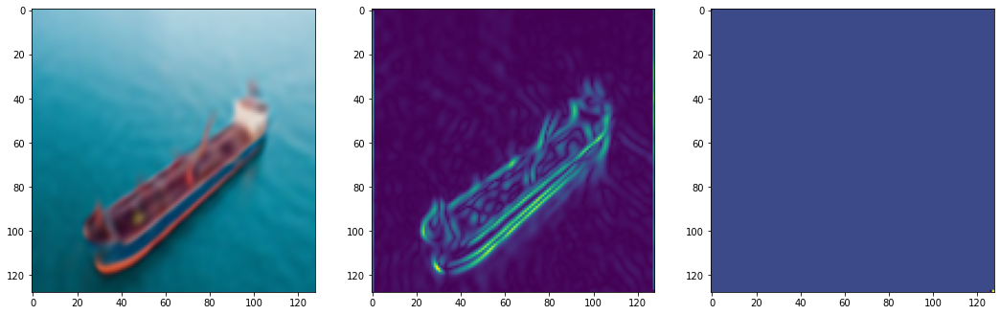

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 280, Total loss 0.000690


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


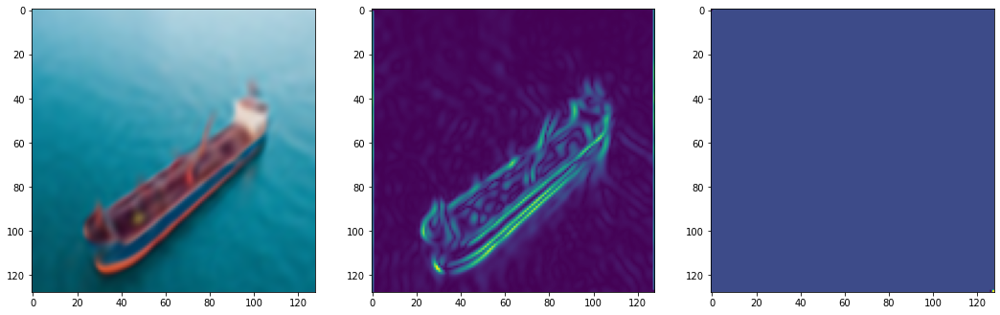

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Step 290, Total loss 0.000674


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


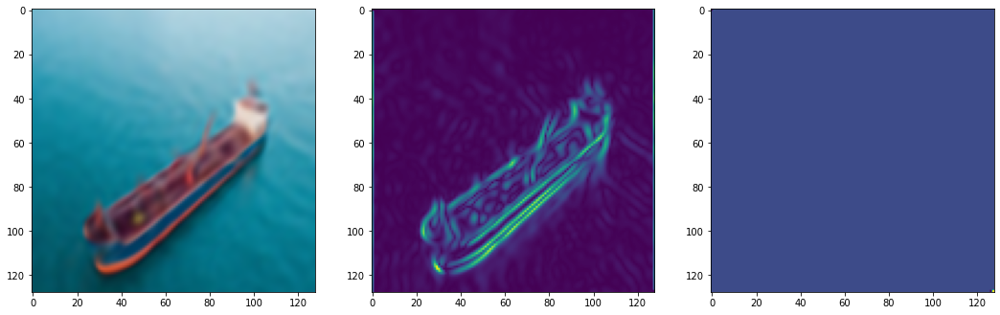

Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])
Output size:  torch.Size([1, 1, 16384, 3])


In [14]:
total_steps = 300 # Since the whole image is our dataset, this just means 500 gradient descent steps.
steps_til_summary = 10

optim = torch.optim.Adam(lr=1e-4, params=img_siren.parameters())

model_input, ground_truth = next(iter(dataloader1))
ground_truth=ground_truth.resize(1, 1, size_img**2, 3)
model_input, ground_truth = model_input.cuda(), ground_truth.cuda()
print("Input, output sizes; ", model_input.size(), ground_truth.size())
print("Model_input: ", model_input[:3, :3])


for step in range(total_steps):
    
    model_output, coords = img_siren(model_input)
    print("Output size: ", model_output.size())
    #print("Groundtruth size: ", ground_truth.size())
    
    loss = ((model_output - ground_truth)**2).mean()
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        img_grad_1 = gradient(model_output, coords)
        img_laplacian = laplace(model_output, coords)

        fig, axes = plt.subplots(1,3, figsize=(18,6))
        #print("Size image: ", model_output.cpu()[:1, :16384, :].size())
        axes[0].imshow(model_output.cpu()[:, :1, :].view(size_img,size_img, 3).detach().numpy())
        axes[1].imshow(img_grad_1.norm(dim=-1).cpu()[:, :1].view(size_img,size_img).detach().numpy())
        axes[2].imshow(img_laplacian.cpu()[:, :1].view(size_img,size_img).detach().numpy())
        plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

Training one model to store image 2: step not necessary in merging

In [15]:
class ImageFitting2(Dataset):
    def __init__(self, sidelength, img_input, nb_images=2):
        super().__init__()
        img = img_input
        img = img_input.reshape(sidelength**2, 3)
        print("Pixels size: ", img.size())
        self.pixels = img
        self.coords = get_mgrid(sidelength, 2, depth=nb_images)
        print("Coords size: ", self.coords.size())

    def __len__(self):
        return 1

    def __getitem__(self, idx):    
        if idx > len(self.pixels): raise IndexError
            
        return self.coords, self.pixels

In [16]:
size_img=128
nb_images=2
img2 = ImageFitting2(size_img, imgB, nb_images=1)
dataloader2 = DataLoader(img2, batch_size=1, pin_memory=True, num_workers=0)

img_siren = Siren(in_features=3, out_features=3, hidden_features=256, 
                  hidden_layers=3, outermost_linear=True)
img_siren.cuda()

Pixels size:  torch.Size([16384, 3])
torch.Size([128]) torch.Size([128]) torch.Size([1])
3
Mgrid step 2:  torch.Size([128, 128, 1, 3])
Mgrid step 3:  torch.Size([1, 16384, 3])
Coords size:  torch.Size([1, 16384, 3])


Siren(
  (net): Sequential(
    (0): SineLayer(
      (linear): Linear(in_features=3, out_features=256, bias=True)
    )
    (1): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (2): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (3): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (4): Linear(in_features=256, out_features=3, bias=True)
  )
)

We get the gradient of the second image

/usr/local/lib/python3.6/dist-packages/torch/tensor.py:447: UserWarning: non-inplace resize is deprecated
  warnings.warn("non-inplace resize is deprecated")


Input, output sizes;  torch.Size([1, 1, 16384, 3]) torch.Size([1, 1, 16384, 3])
Model_input:  tensor([[[[-1.0000, -1.0000, -1.0000],
          [-1.0000, -0.9843, -1.0000],
          [-1.0000, -0.9685, -1.0000],
          ...,
          [ 1.0000,  0.9685, -1.0000],
          [ 1.0000,  0.9843, -1.0000],
          [ 1.0000,  1.0000, -1.0000]]]], device='cuda:0')
Step 0, Total loss 0.229650


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


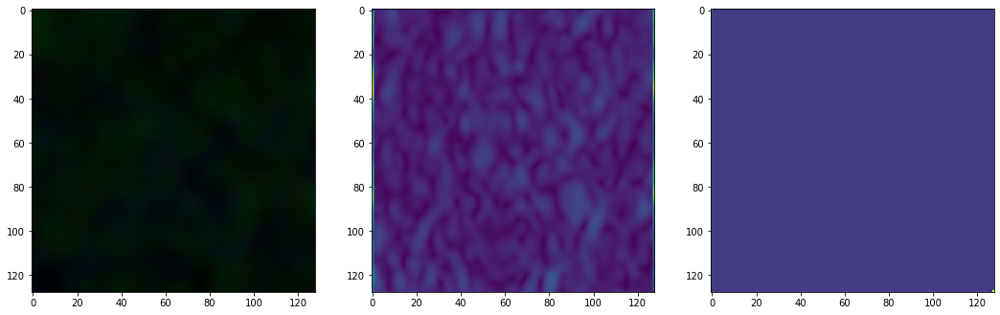

Step 10, Total loss 0.016181
Size image:  torch.Size([1, 1, 16384, 3])


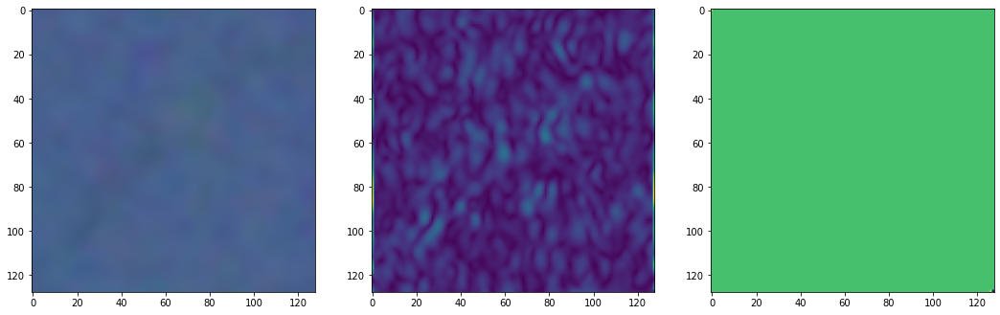

Step 20, Total loss 0.005436
Size image:  torch.Size([1, 1, 16384, 3])


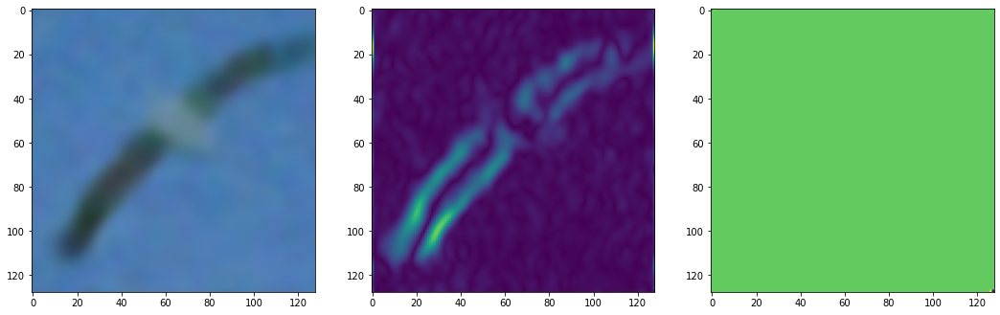

Step 30, Total loss 0.003719
Size image:  torch.Size([1, 1, 16384, 3])


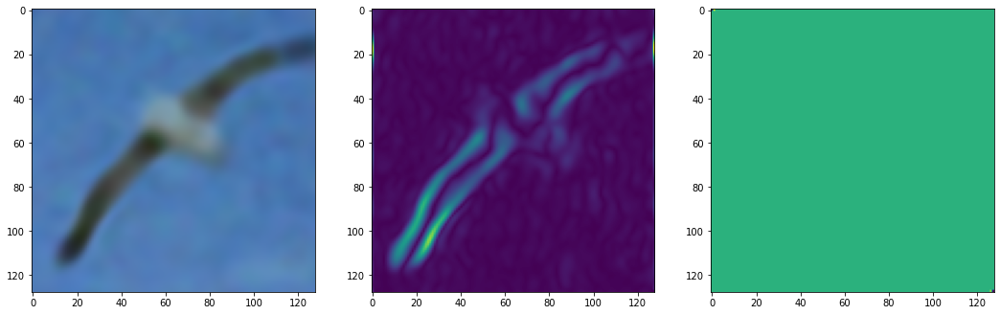

Step 40, Total loss 0.002872
Size image:  torch.Size([1, 1, 16384, 3])


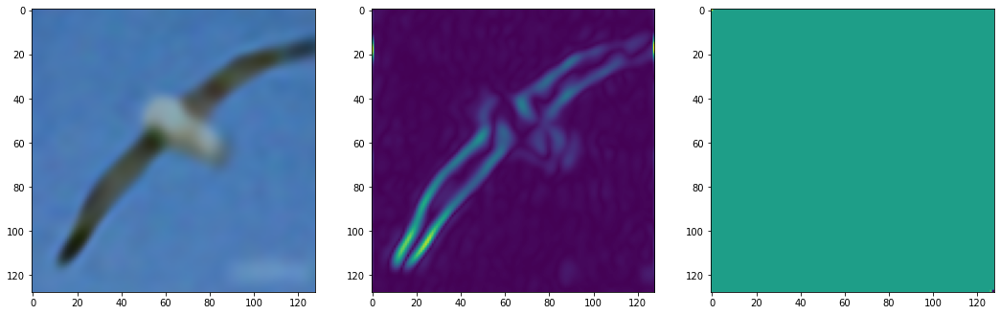

Step 50, Total loss 0.002310
Size image:  torch.Size([1, 1, 16384, 3])


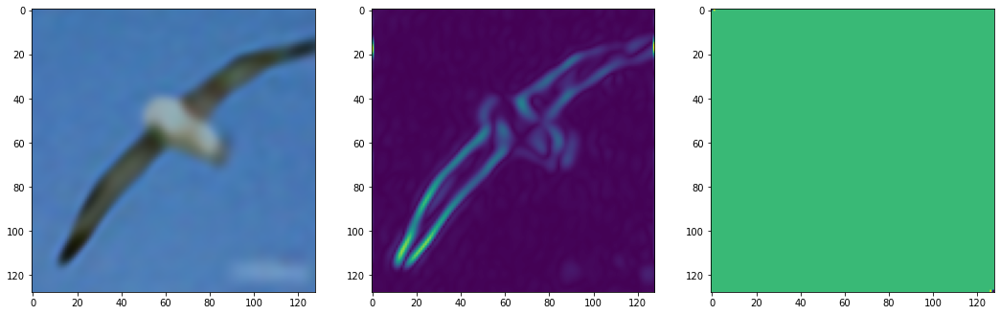

Step 60, Total loss 0.001880
Size image:  torch.Size([1, 1, 16384, 3])


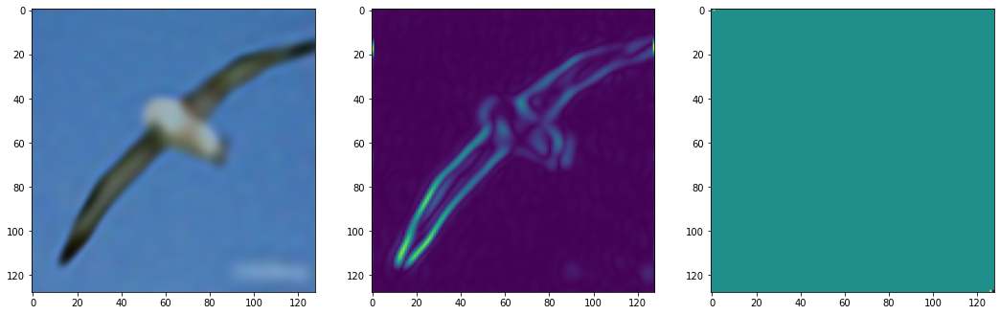

Step 70, Total loss 0.001546
Size image:  torch.Size([1, 1, 16384, 3])


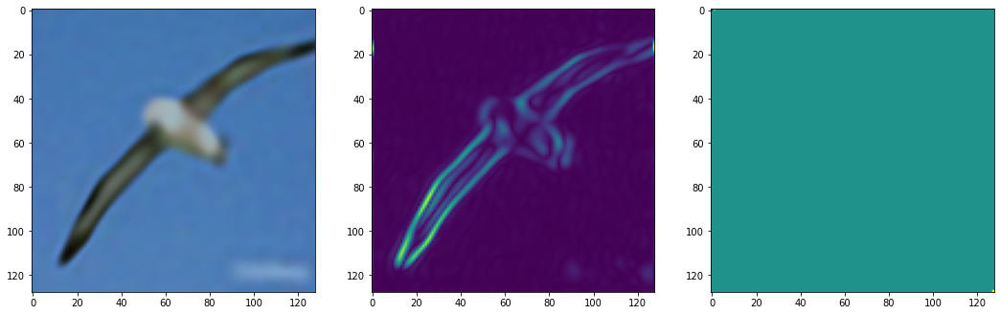

Step 80, Total loss 0.001317
Size image:  torch.Size([1, 1, 16384, 3])


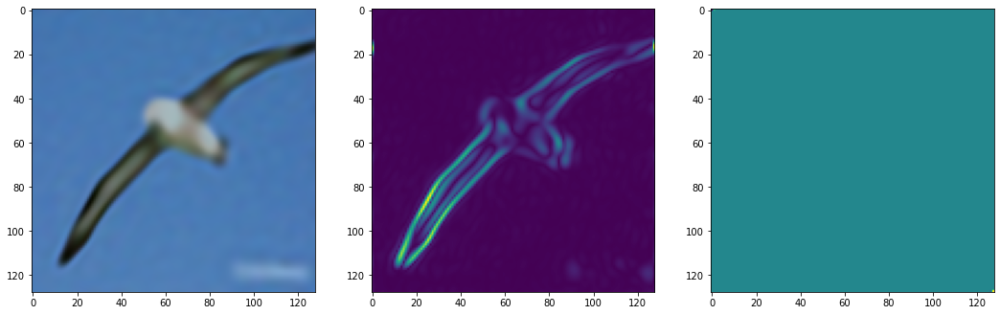

Step 90, Total loss 0.001158


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


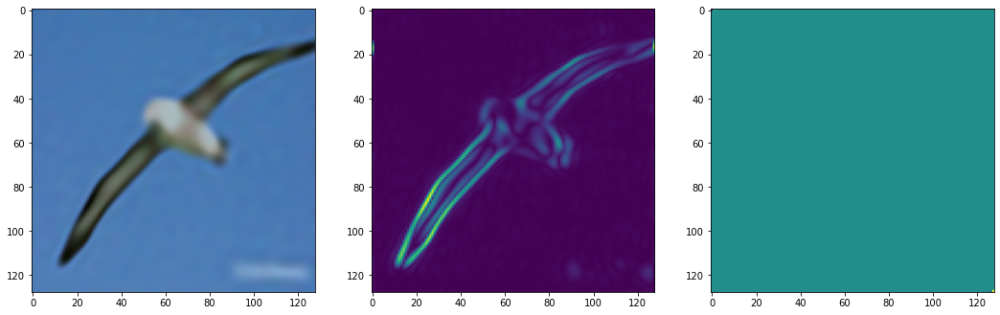

Step 100, Total loss 0.001035


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


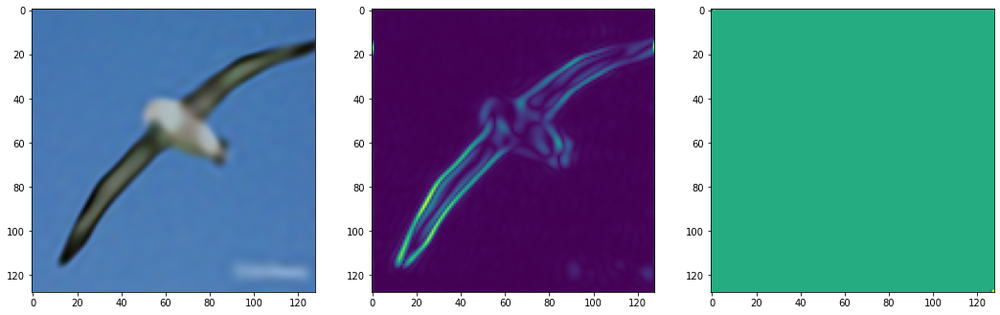

Step 110, Total loss 0.000934
Size image:  torch.Size([1, 1, 16384, 3])


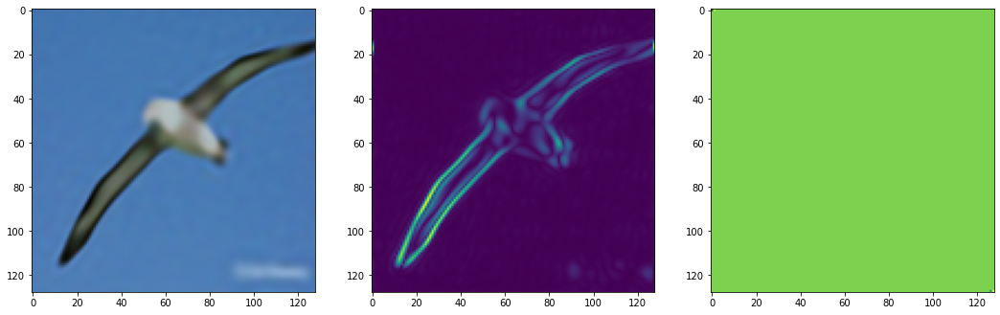

Step 120, Total loss 0.000849
Size image:  torch.Size([1, 1, 16384, 3])


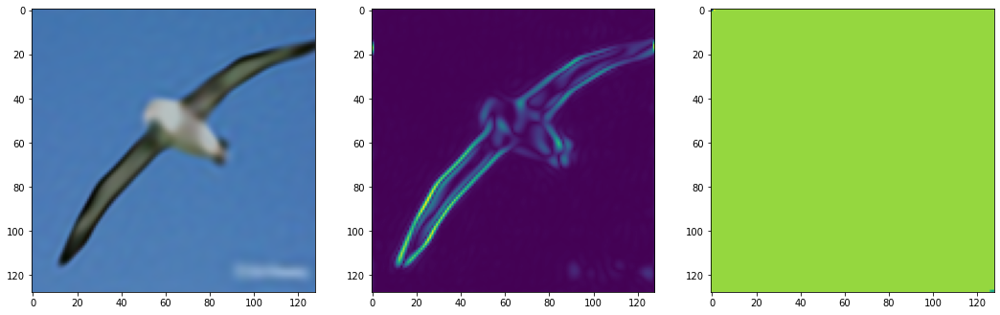

Step 130, Total loss 0.000775
Size image:  torch.Size([1, 1, 16384, 3])


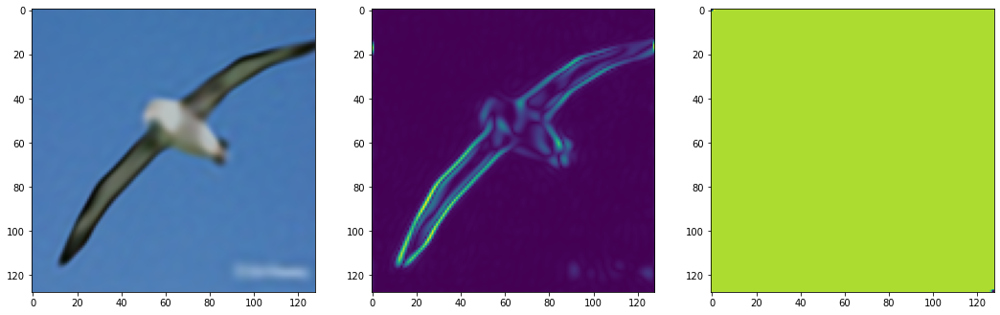

Step 140, Total loss 0.000711
Size image:  torch.Size([1, 1, 16384, 3])


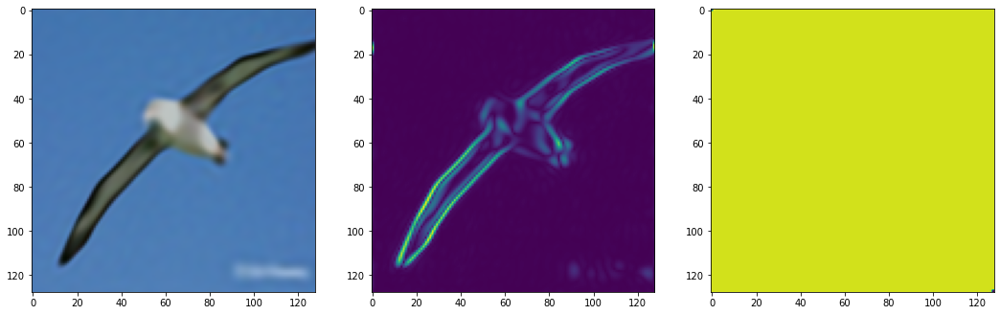

Step 150, Total loss 0.000655
Size image:  torch.Size([1, 1, 16384, 3])


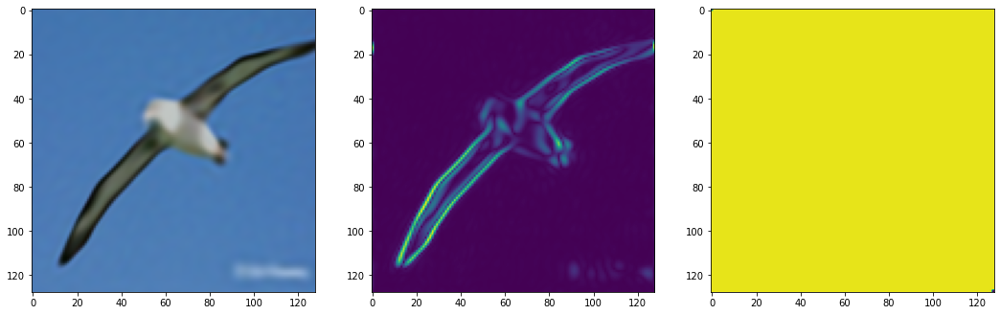

Step 160, Total loss 0.000606
Size image:  torch.Size([1, 1, 16384, 3])


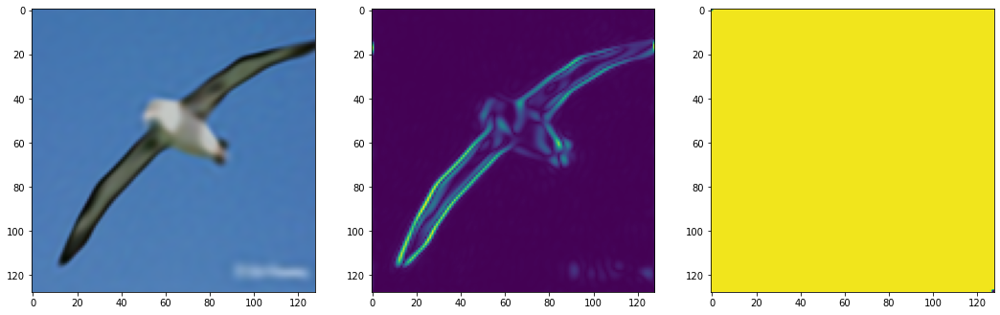

Step 170, Total loss 0.000562
Size image:  torch.Size([1, 1, 16384, 3])


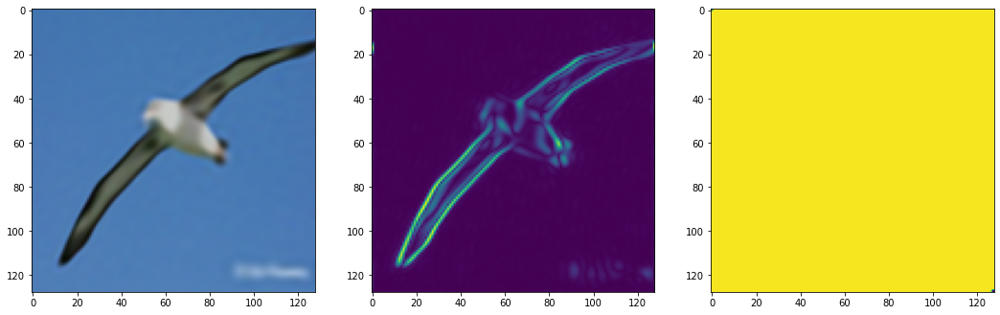

Step 180, Total loss 0.000522
Size image:  torch.Size([1, 1, 16384, 3])


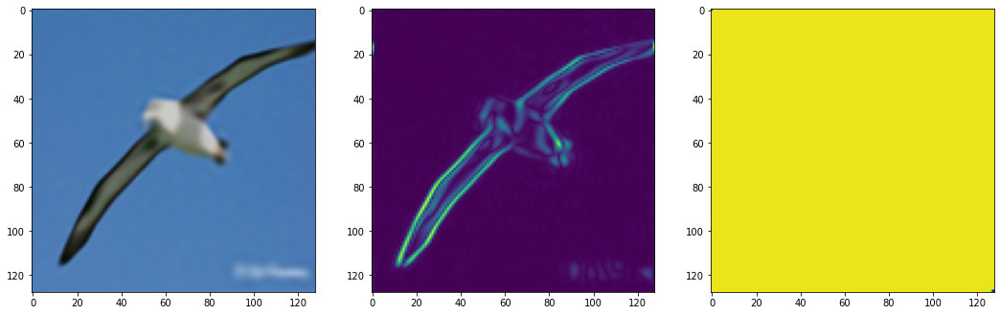

Step 190, Total loss 0.000486
Size image:  torch.Size([1, 1, 16384, 3])


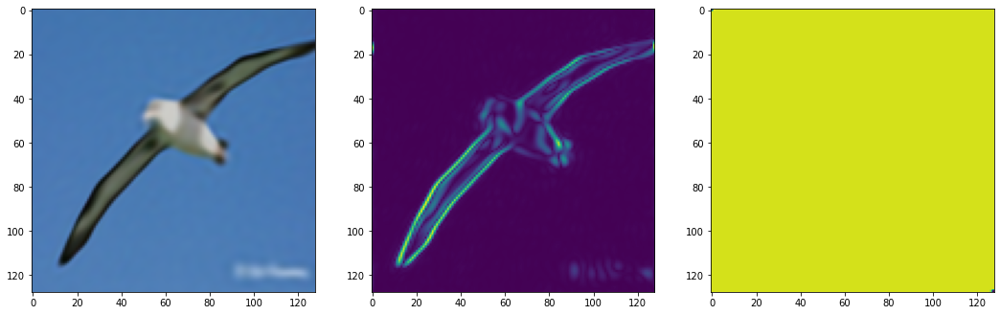

Step 200, Total loss 0.000454
Size image:  torch.Size([1, 1, 16384, 3])


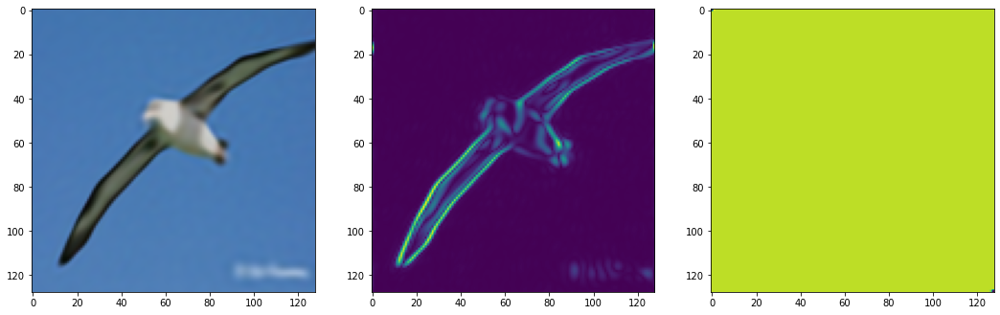

Step 210, Total loss 0.000424
Size image:  torch.Size([1, 1, 16384, 3])


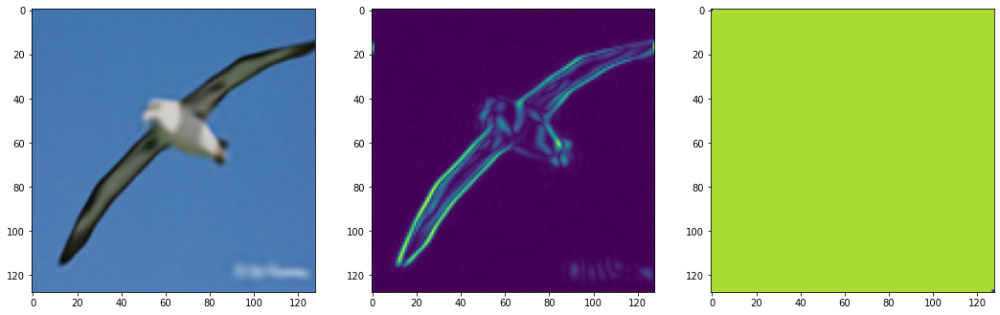

Step 220, Total loss 0.000397
Size image:  torch.Size([1, 1, 16384, 3])


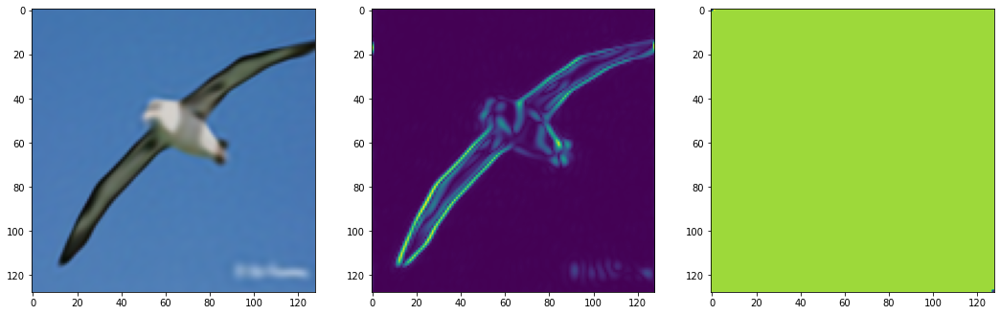

Step 230, Total loss 0.000372
Size image:  torch.Size([1, 1, 16384, 3])


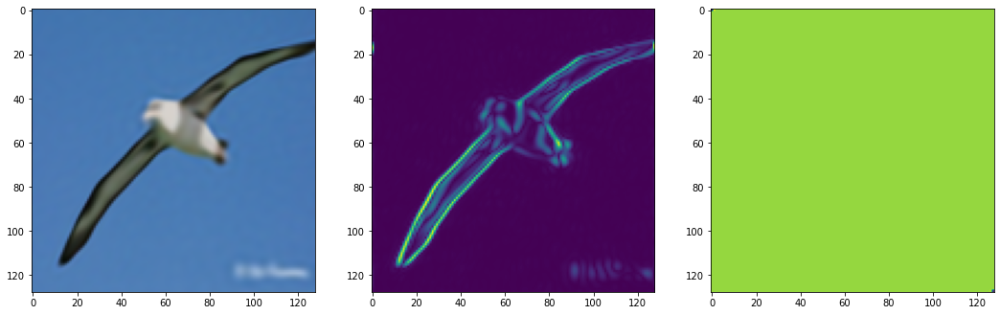

Step 240, Total loss 0.000349
Size image:  torch.Size([1, 1, 16384, 3])


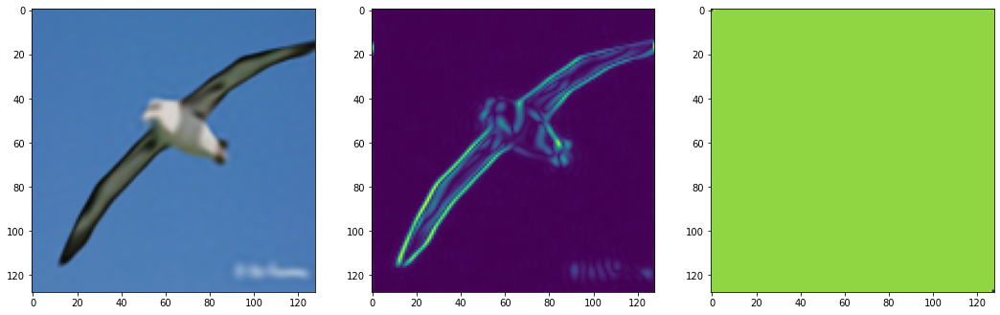

Step 250, Total loss 0.000328
Size image:  torch.Size([1, 1, 16384, 3])


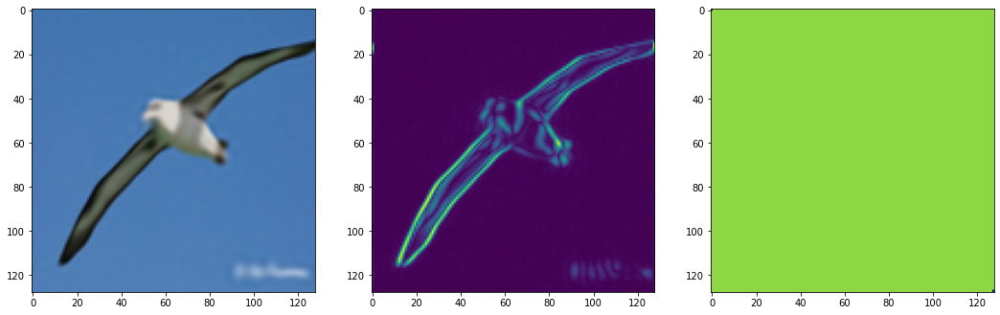

Step 260, Total loss 0.000309
Size image:  torch.Size([1, 1, 16384, 3])


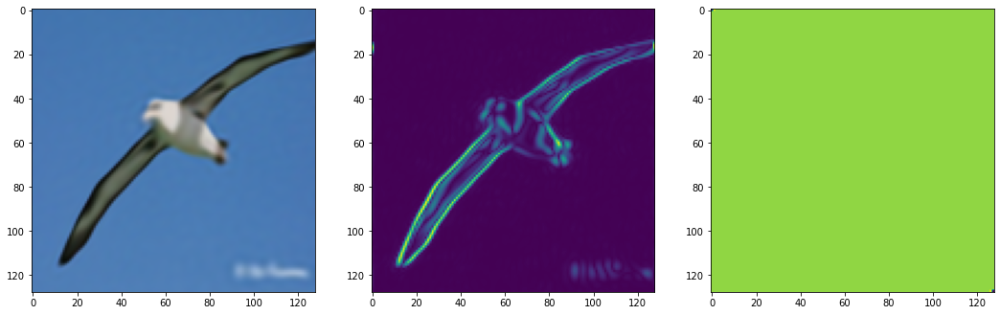

Step 270, Total loss 0.000290
Size image:  torch.Size([1, 1, 16384, 3])


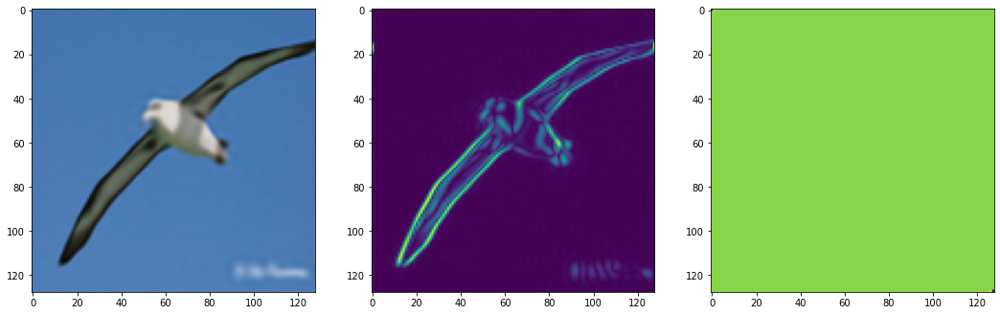

Step 280, Total loss 0.000274
Size image:  torch.Size([1, 1, 16384, 3])


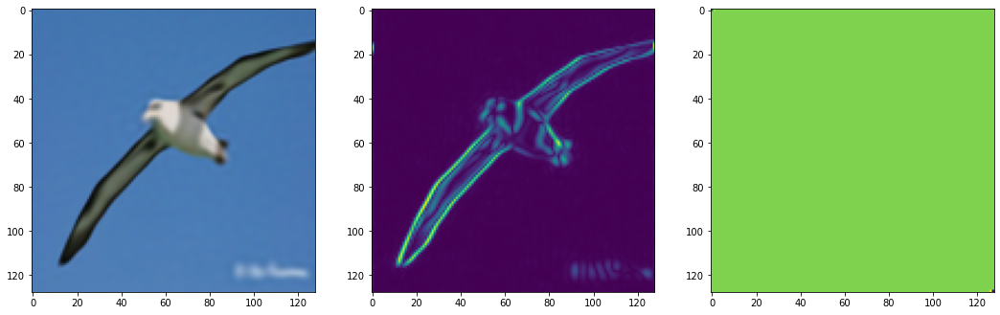

Step 290, Total loss 0.000258
Size image:  torch.Size([1, 1, 16384, 3])


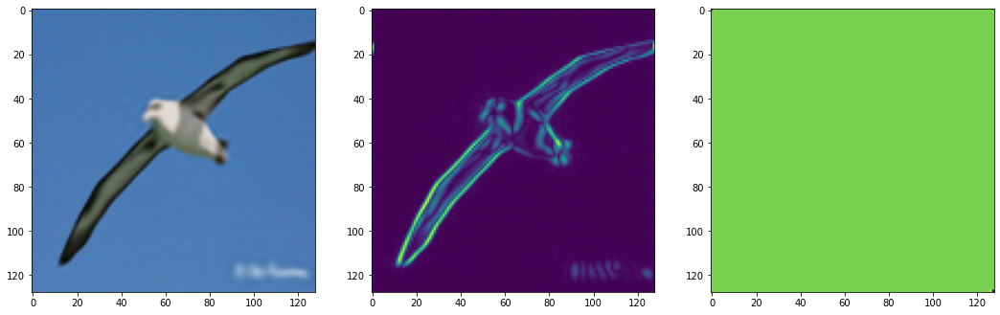

Step 300, Total loss 0.000244
Size image:  torch.Size([1, 1, 16384, 3])


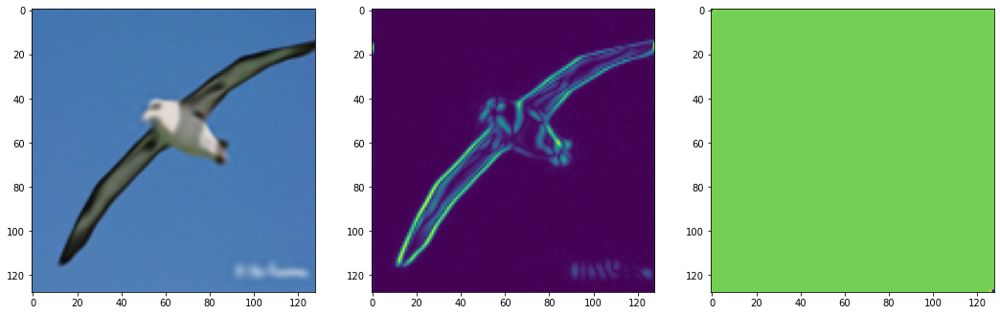

Step 310, Total loss 0.000231
Size image:  torch.Size([1, 1, 16384, 3])


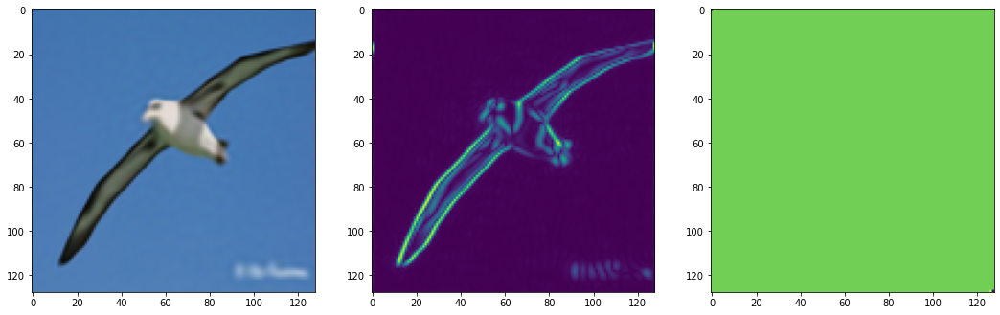

Step 320, Total loss 0.000219
Size image:  torch.Size([1, 1, 16384, 3])


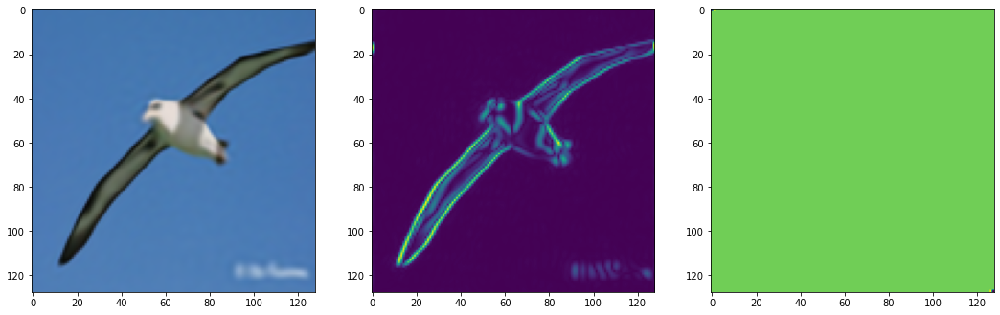

Step 330, Total loss 0.000207
Size image:  torch.Size([1, 1, 16384, 3])


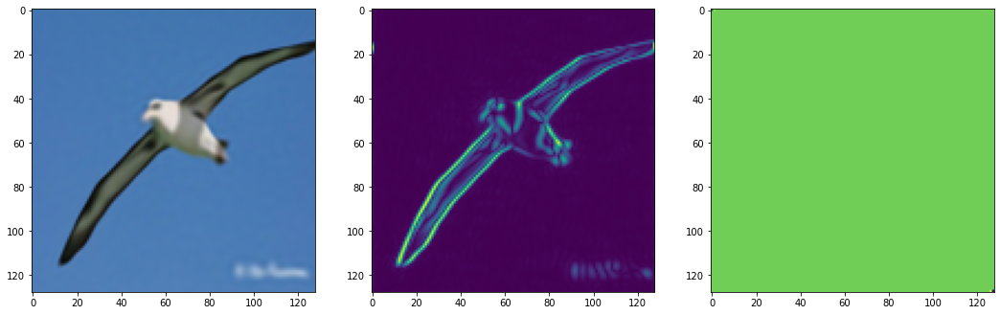

Step 340, Total loss 0.000197
Size image:  torch.Size([1, 1, 16384, 3])


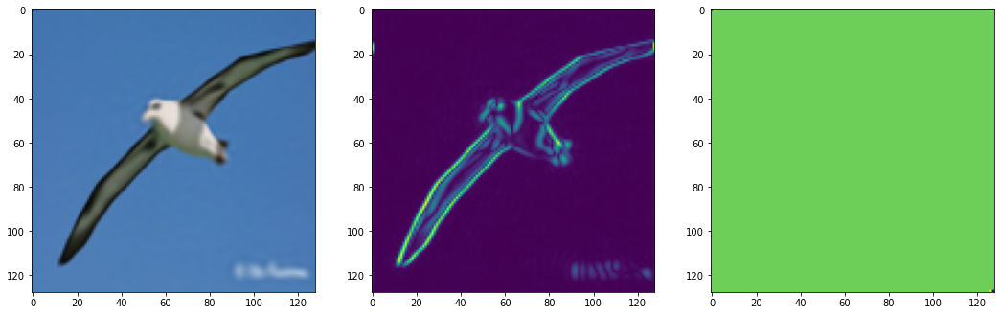

Step 350, Total loss 0.000188
Size image:  torch.Size([1, 1, 16384, 3])


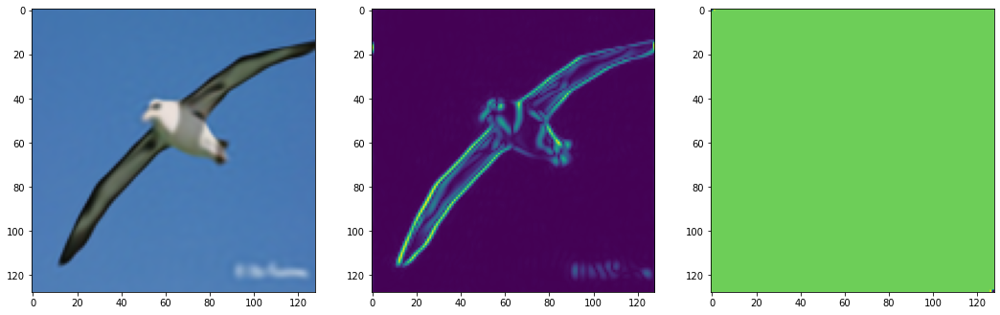

Step 360, Total loss 0.000179
Size image:  torch.Size([1, 1, 16384, 3])


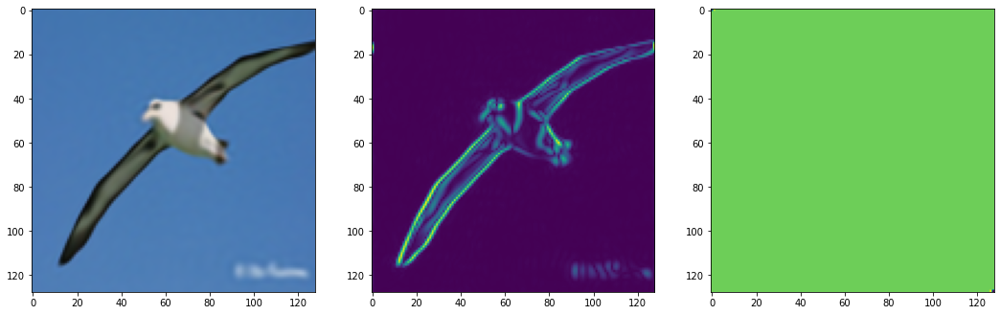

Step 370, Total loss 0.000171
Size image:  torch.Size([1, 1, 16384, 3])


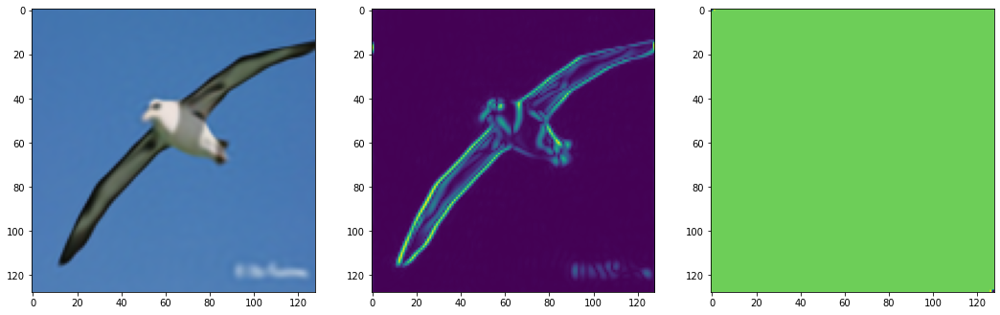

Step 380, Total loss 0.000164
Size image:  torch.Size([1, 1, 16384, 3])


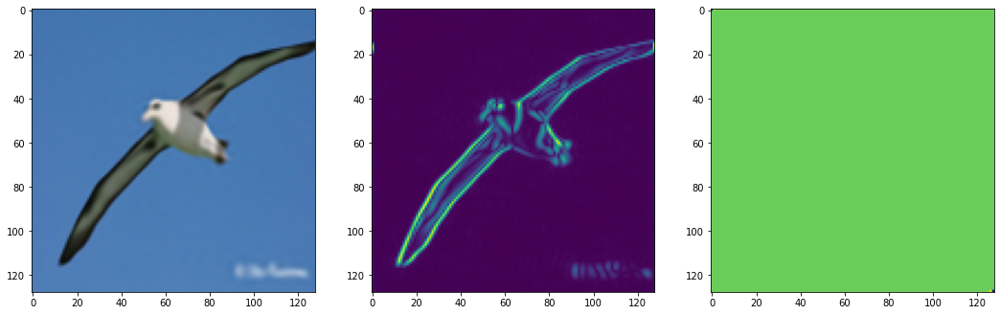

Step 390, Total loss 0.000157
Size image:  torch.Size([1, 1, 16384, 3])


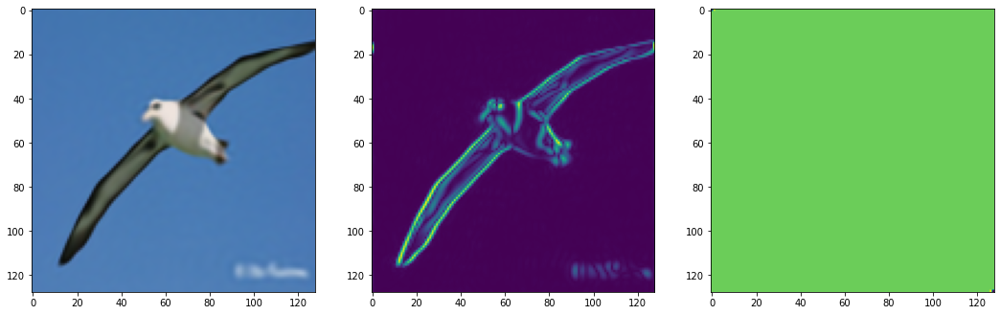

Step 400, Total loss 0.000151
Size image:  torch.Size([1, 1, 16384, 3])


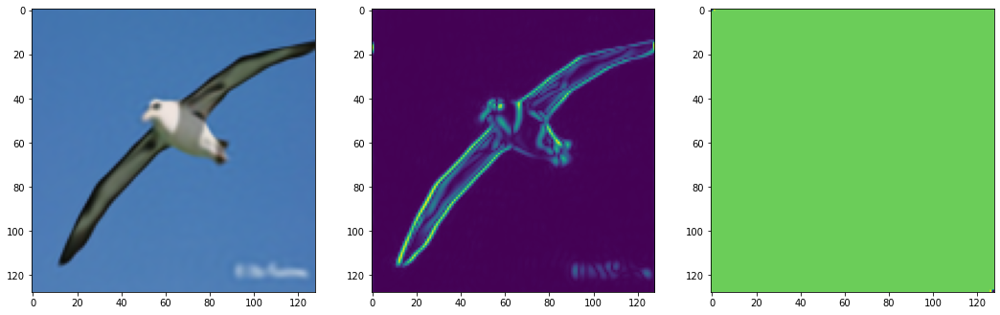

Step 410, Total loss 0.000145
Size image:  torch.Size([1, 1, 16384, 3])


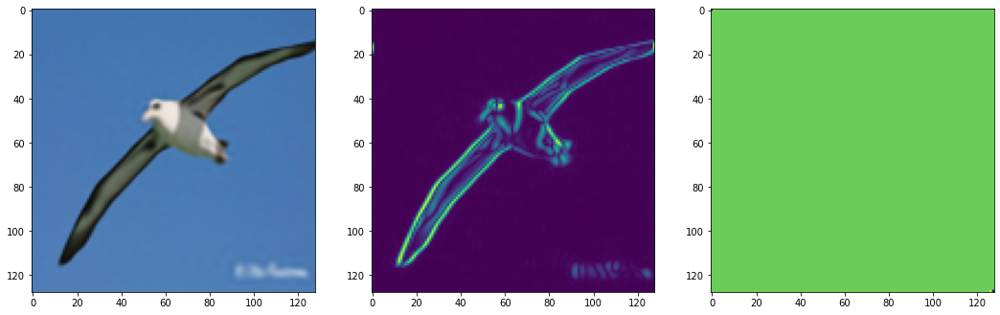

Step 420, Total loss 0.000140
Size image:  torch.Size([1, 1, 16384, 3])


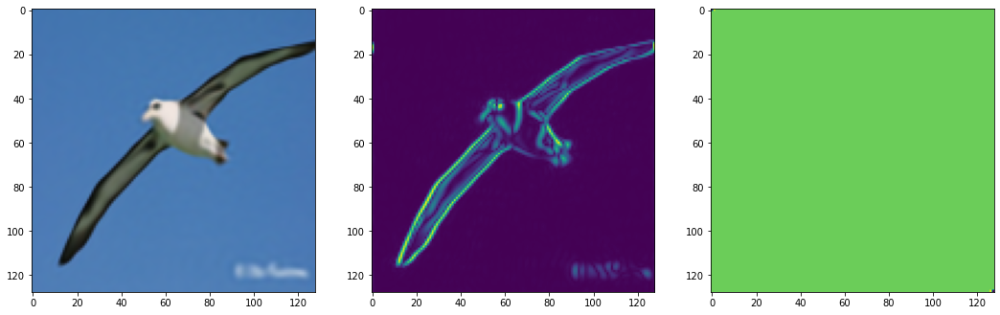

Step 430, Total loss 0.000135
Size image:  torch.Size([1, 1, 16384, 3])


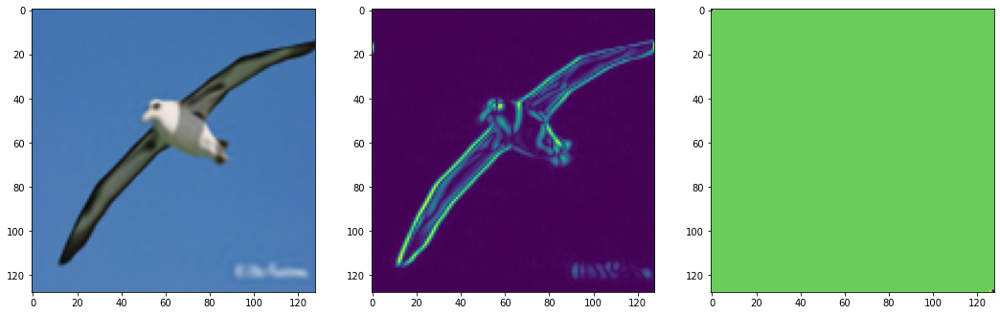

Step 440, Total loss 0.000131
Size image:  torch.Size([1, 1, 16384, 3])


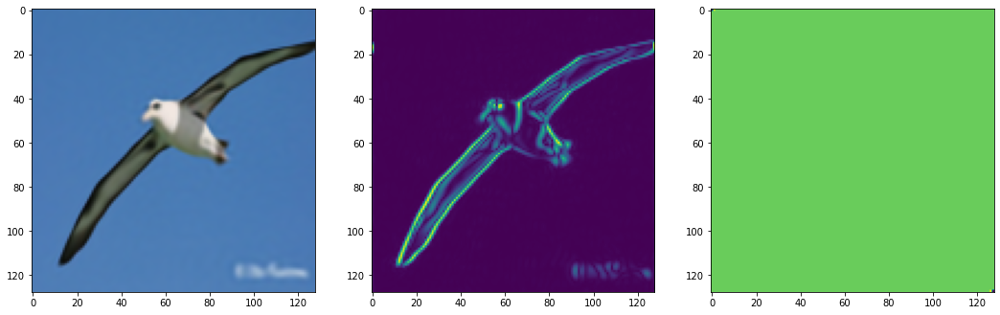

Step 450, Total loss 0.000127
Size image:  torch.Size([1, 1, 16384, 3])


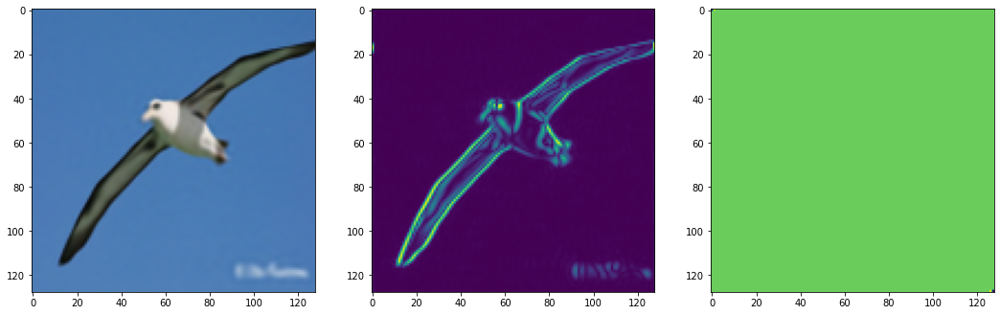

Step 460, Total loss 0.000123
Size image:  torch.Size([1, 1, 16384, 3])


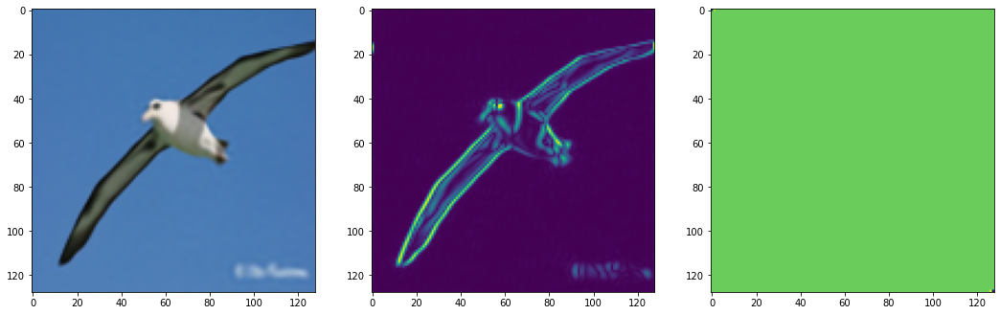

Step 470, Total loss 0.000120
Size image:  torch.Size([1, 1, 16384, 3])


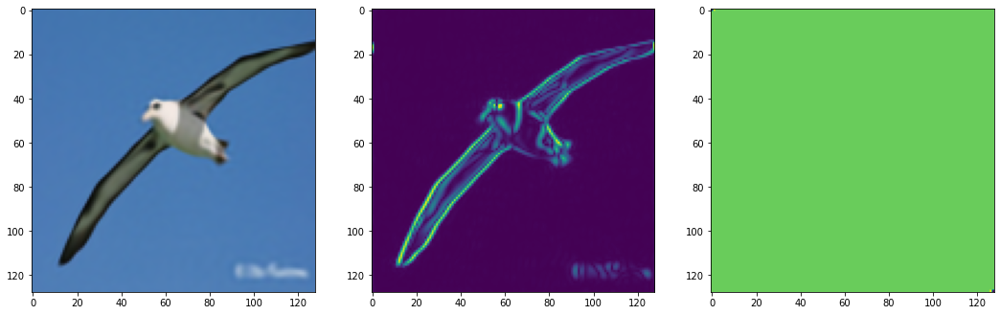

Step 480, Total loss 0.000116
Size image:  torch.Size([1, 1, 16384, 3])


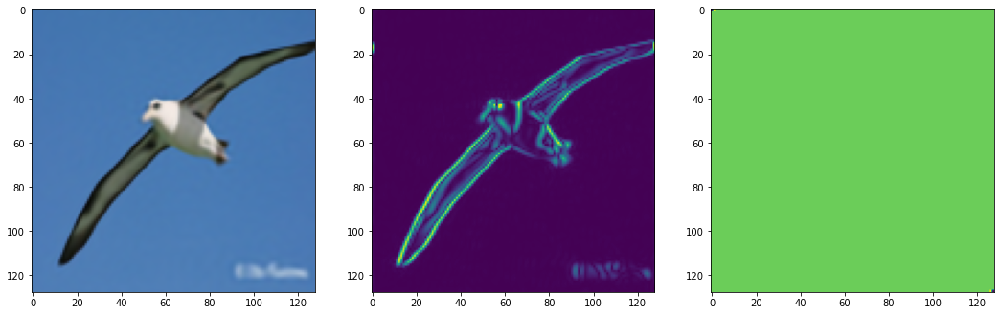

Step 490, Total loss 0.000113
Size image:  torch.Size([1, 1, 16384, 3])


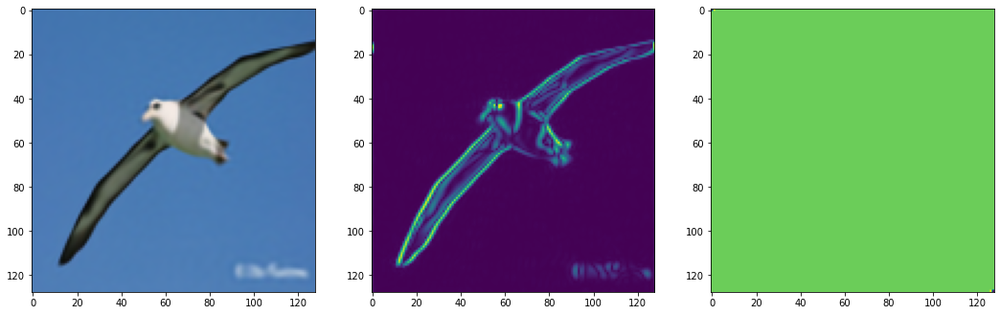

In [17]:
total_steps = 500 # Since the whole image is our dataset, this just means 500 gradient descent steps.
steps_til_summary = 10

optim = torch.optim.Adam(lr=1e-4, params=img_siren.parameters())

model_input, ground_truth = next(iter(dataloader2))
ground_truth=ground_truth.resize(1, 1, size_img**2, 3)
model_input, ground_truth = model_input.cuda(), ground_truth.cuda()
print("Input, output sizes; ", model_input.size(), ground_truth.size())
print("Model_input: ", model_input[:3, :3])


#we determine the gradient
#model_input.requires_grad_()
#img_grad_truth=gradient(ground_truth, model_input)

for step in range(total_steps):
    
    model_output, coords = img_siren(model_input)
    #print("Output size: ", model_output.size())
    #print("Groundtruth size: ", ground_truth.size())
    
    loss = ((model_output - ground_truth)**2).mean()
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        img_grad_2 = gradient(model_output, coords)
        img_laplacian = laplace(model_output, coords)

        fig, axes = plt.subplots(1,3, figsize=(18,6))
        print("Size image: ", model_output.cpu()[:1, :16384, :].size())
        axes[0].imshow(model_output.cpu()[:, :1, :].view(size_img,size_img, 3).detach().numpy())
        axes[1].imshow(img_grad_2.norm(dim=-1).cpu()[:, :1].view(size_img,size_img).detach().numpy())
        axes[2].imshow(img_laplacian.cpu()[:, :1].view(size_img,size_img).detach().numpy())
        plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

we merge the 2 gradients together, and train a model to output the correct image

In [18]:
img_grad_aim=(img_grad_1+img_grad_2).detach()

In [19]:
print(img_grad_aim.size())

torch.Size([1, 1, 16384, 3])


In [20]:
size_img=128
nb_images=1
"""
cameraman = ImageFitting(size_img, nb_images=nb_images)
dataloader1 = DataLoader(cameraman, batch_size=1, pin_memory=True, num_workers=0)
"""
img_siren = Siren(in_features=3, out_features=3, hidden_features=256, 
                  hidden_layers=3, outermost_linear=True)
img_siren.cuda()

Siren(
  (net): Sequential(
    (0): SineLayer(
      (linear): Linear(in_features=3, out_features=256, bias=True)
    )
    (1): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (2): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (3): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (4): Linear(in_features=256, out_features=3, bias=True)
  )
)

/usr/local/lib/python3.6/dist-packages/torch/tensor.py:447: UserWarning: non-inplace resize is deprecated
  warnings.warn("non-inplace resize is deprecated")


Input, output sizes;  torch.Size([1, 1, 16384, 3]) torch.Size([1, 1, 16384, 3])
Step 9, Total loss 0.001051


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


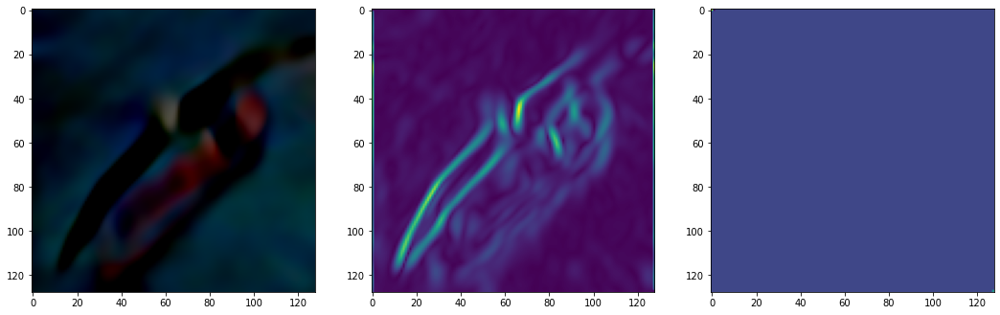

Step 19, Total loss 0.000427


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


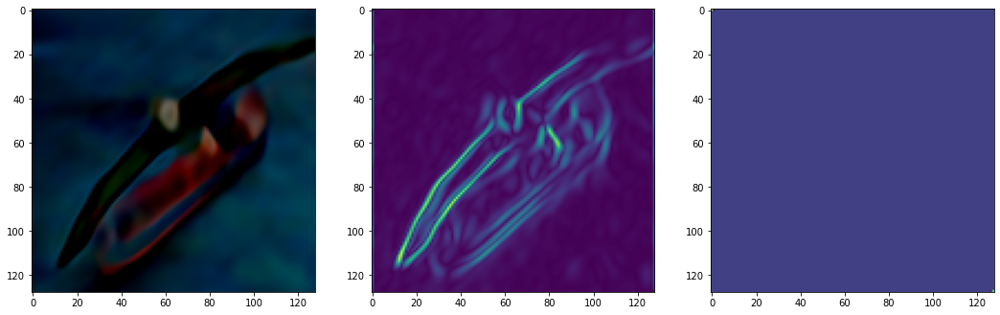

Step 29, Total loss 0.000168


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


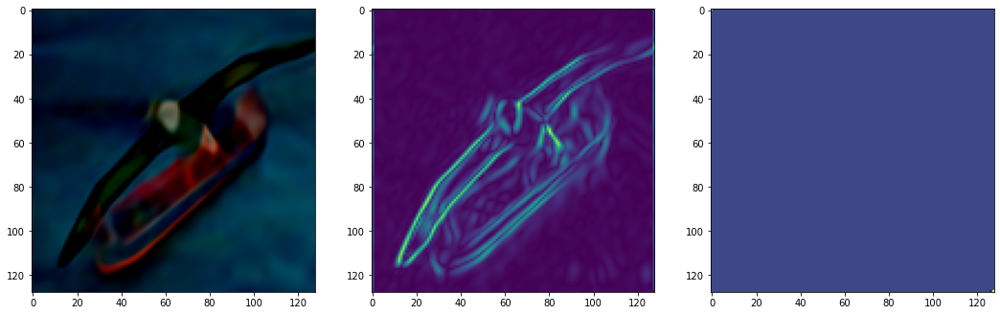

Step 39, Total loss 0.000078


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


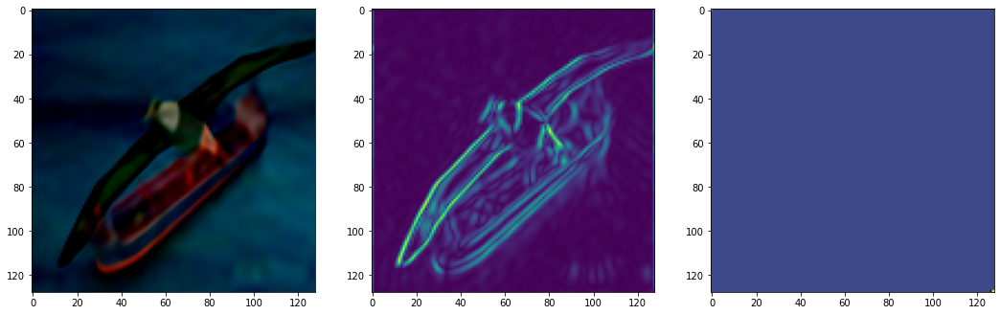

Step 49, Total loss 0.000039


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


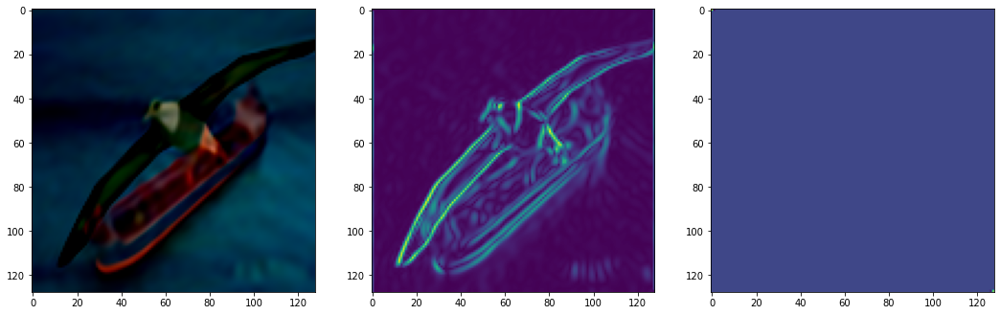

Step 59, Total loss 0.000021


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


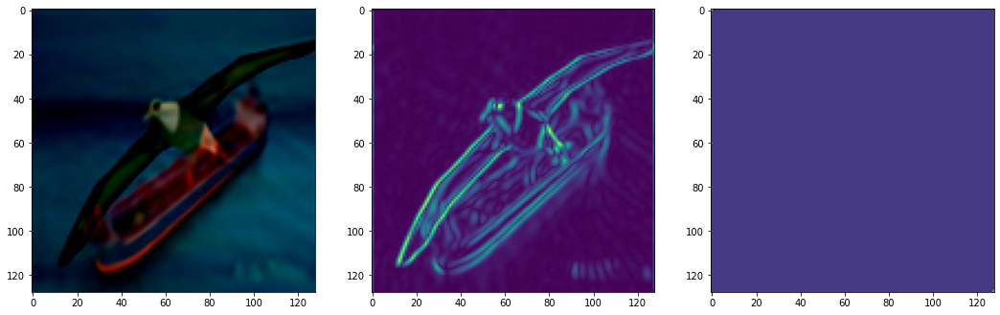

Step 69, Total loss 0.000013


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


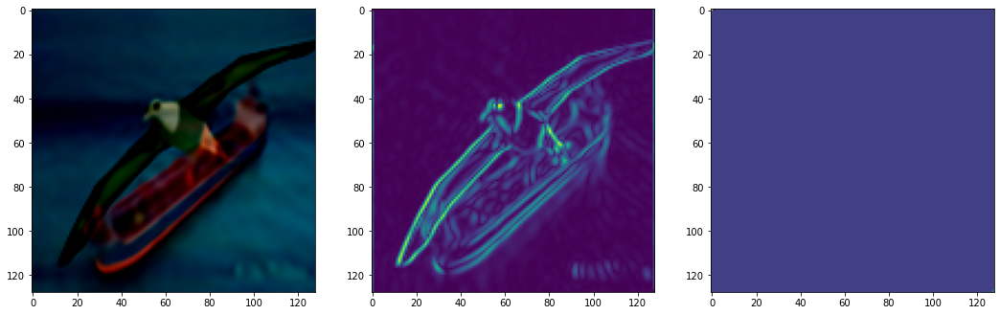

Step 79, Total loss 0.000009


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


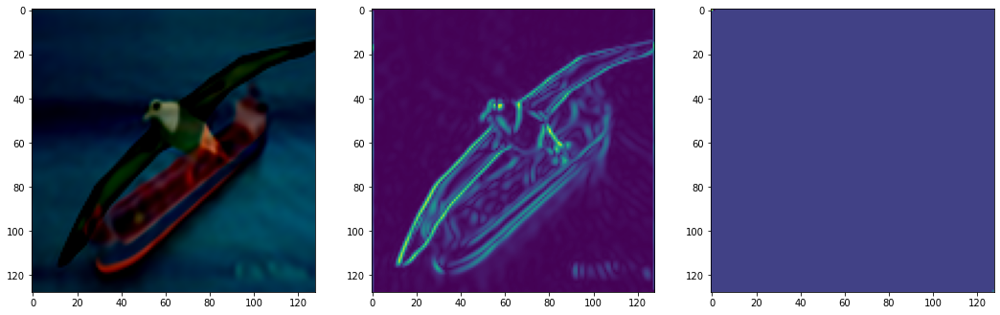

Step 89, Total loss 0.000007


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


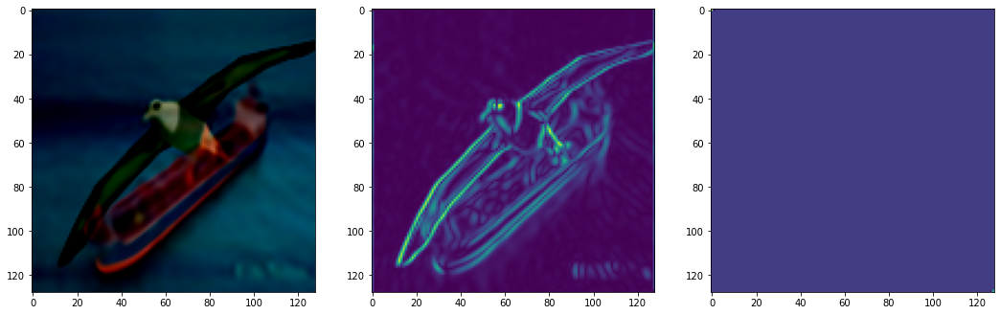

Step 99, Total loss 0.000005


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


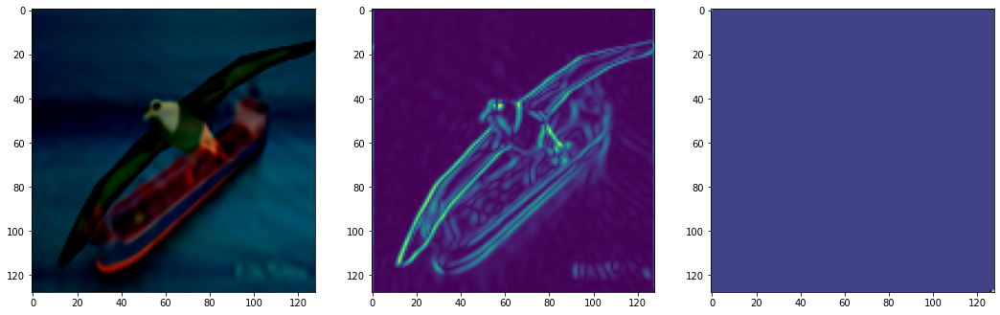

Step 109, Total loss 0.000004


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


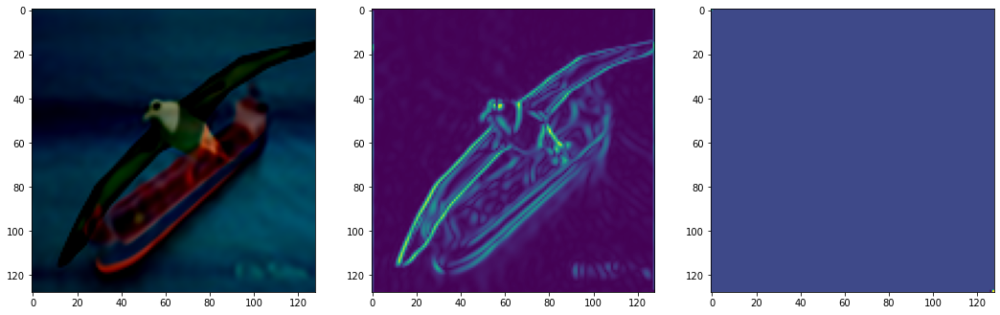

Step 119, Total loss 0.000006


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


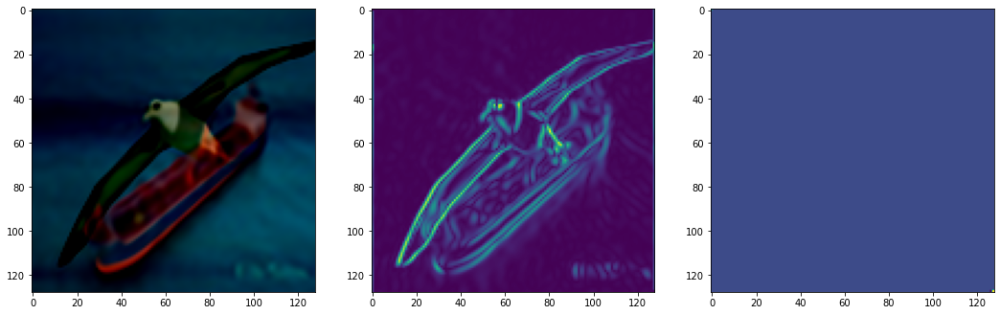

Step 129, Total loss 0.000006


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


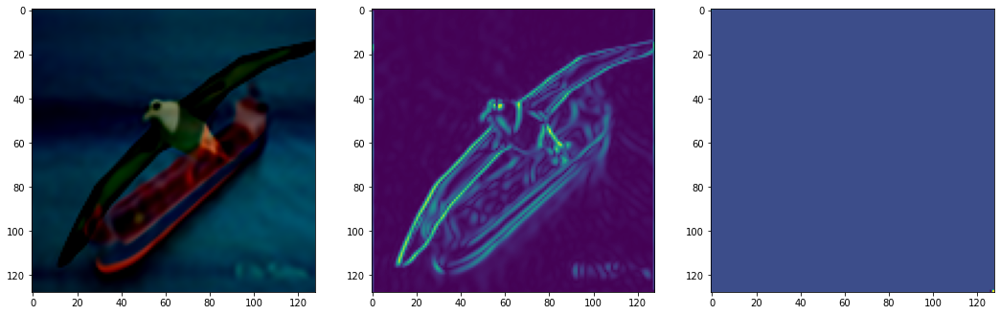

Step 139, Total loss 0.000003


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


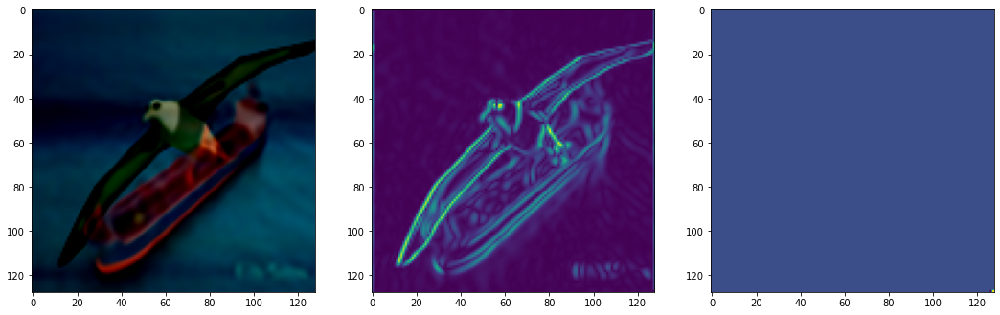

Step 149, Total loss 0.000002


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


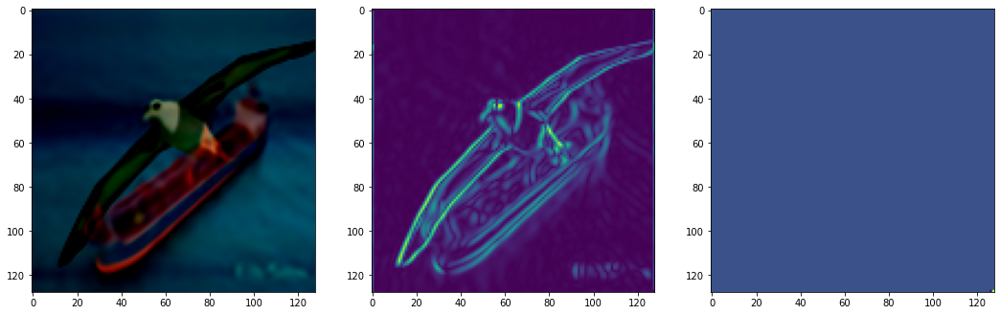

Step 159, Total loss 0.000005


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


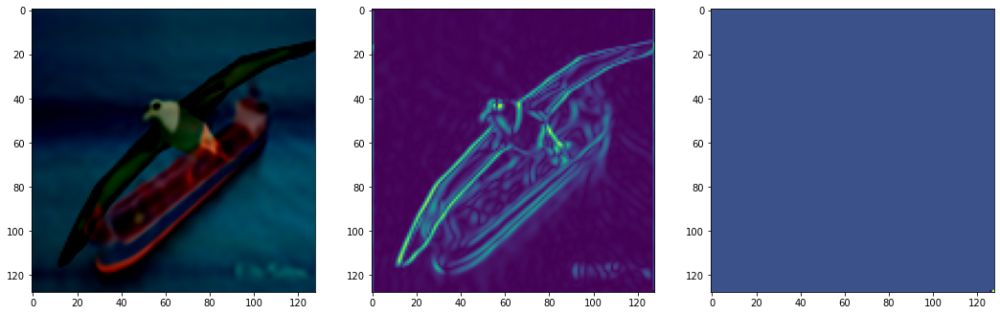

Step 169, Total loss 0.000006


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


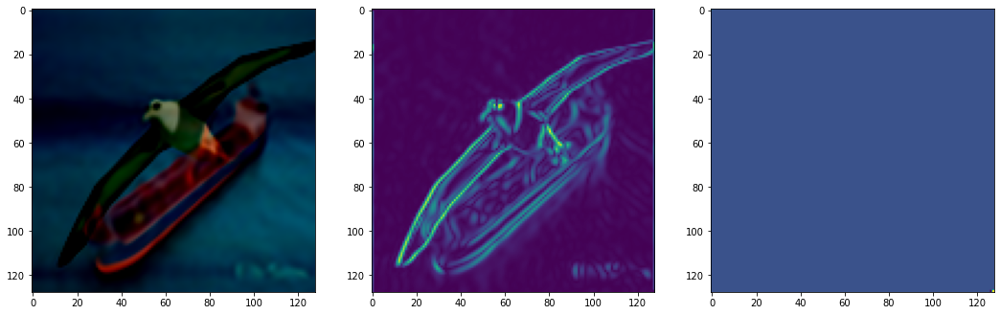

Step 179, Total loss 0.000002


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


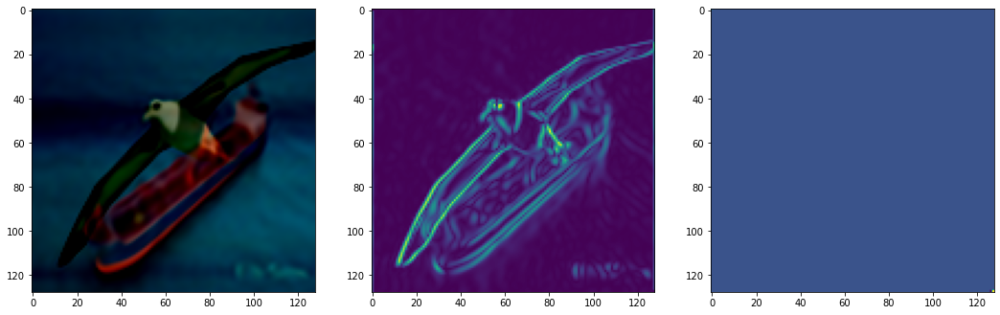

Step 189, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


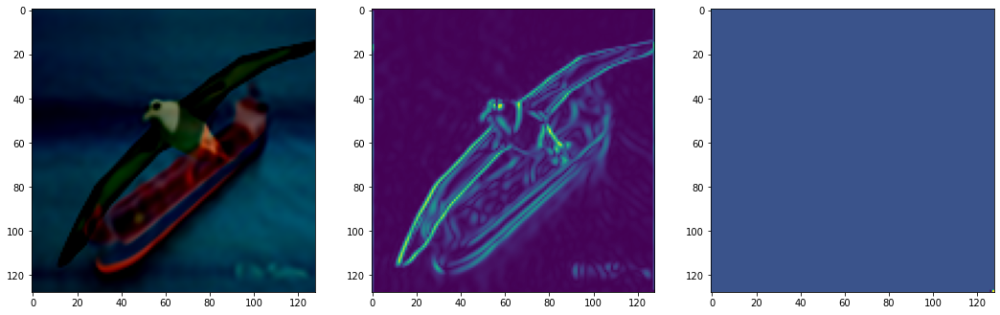

Step 199, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


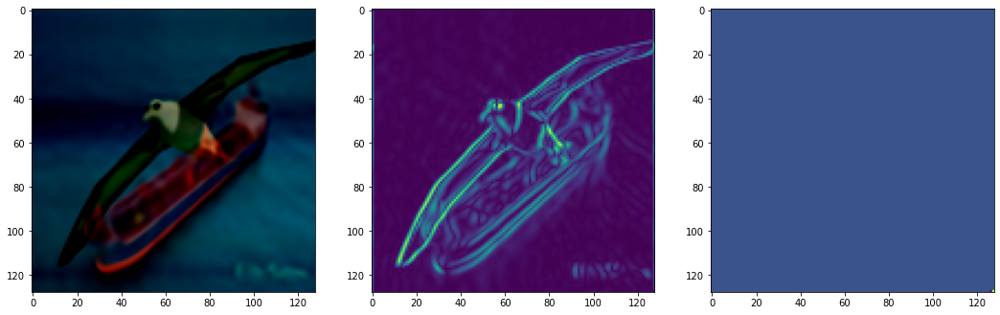

Step 209, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


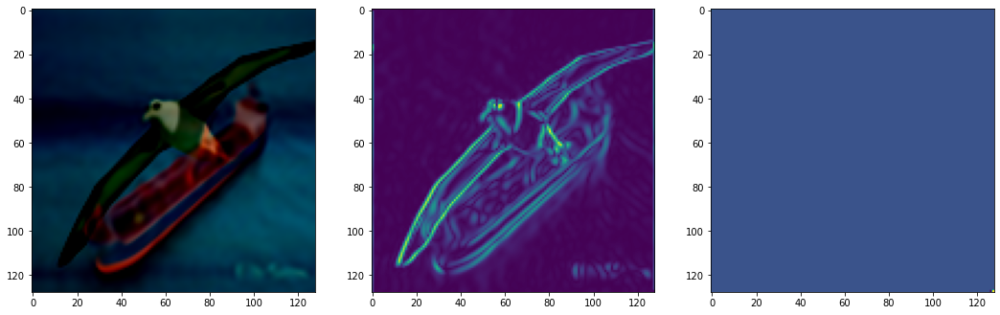

Step 219, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


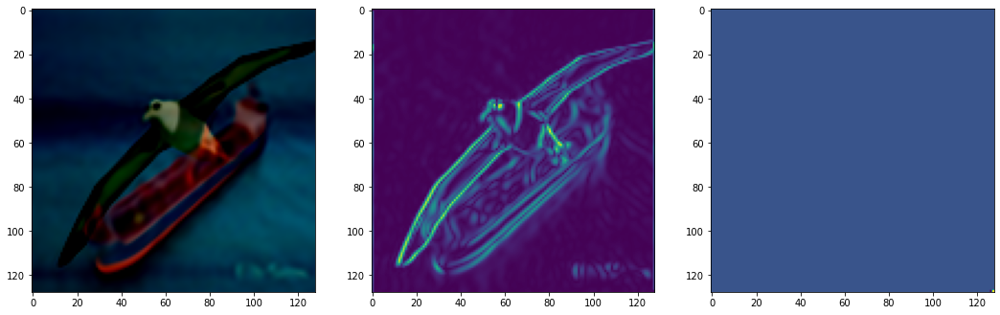

Step 229, Total loss 0.000006


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


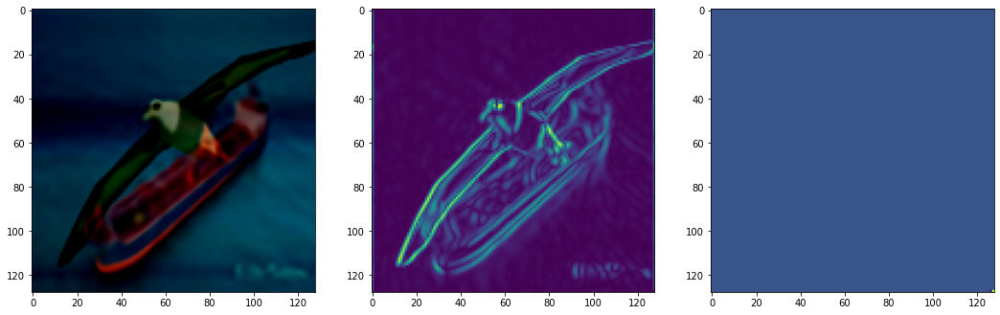

Step 239, Total loss 0.000003


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


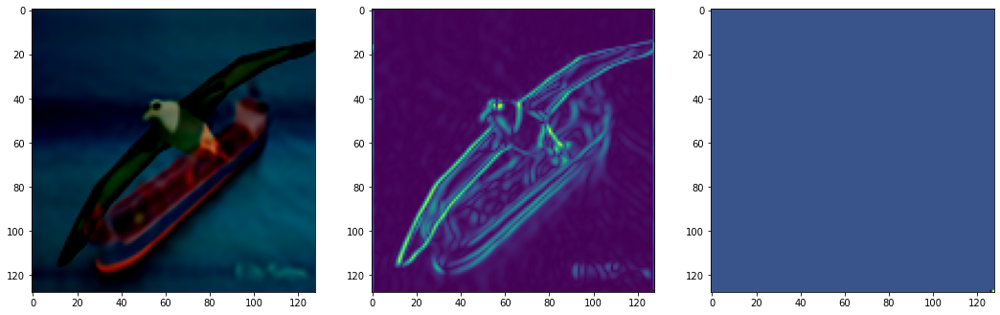

Step 249, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


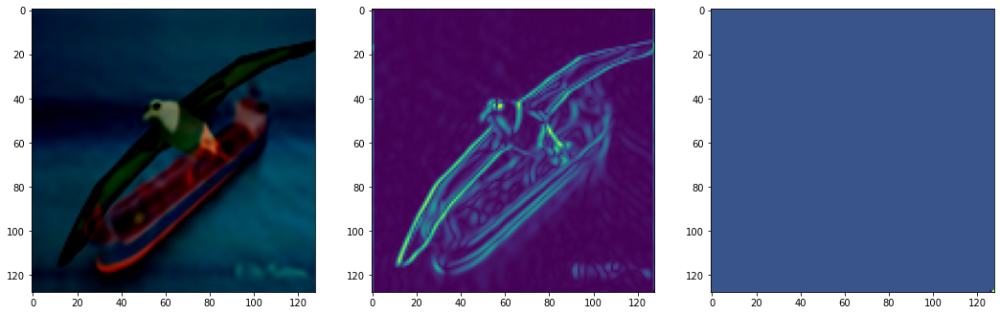

Step 259, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


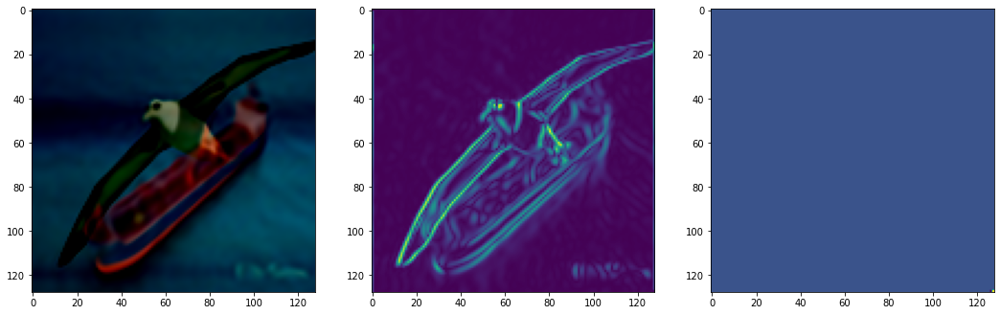

Step 269, Total loss 0.000003


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


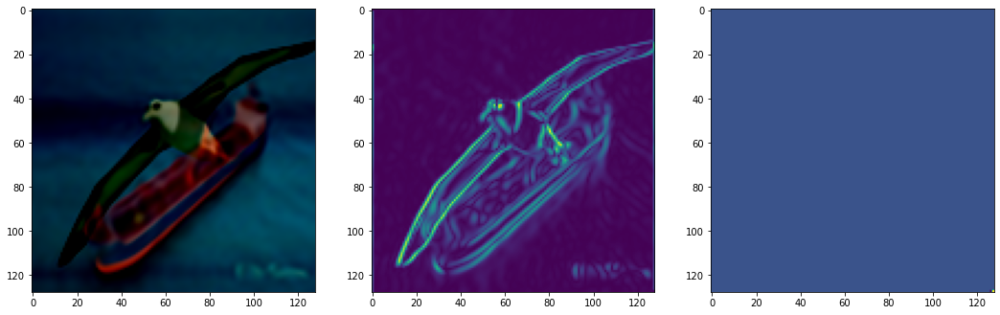

Step 279, Total loss 0.000002


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


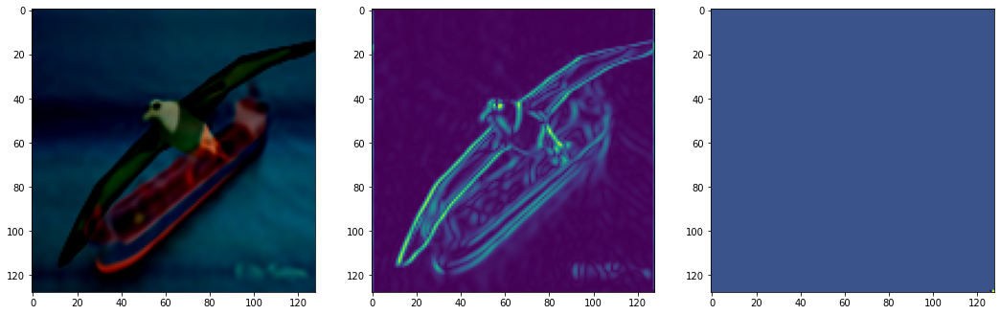

Step 289, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


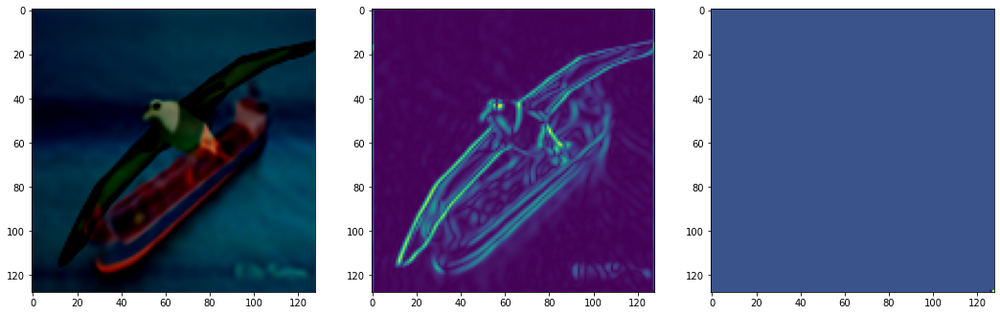

Step 299, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


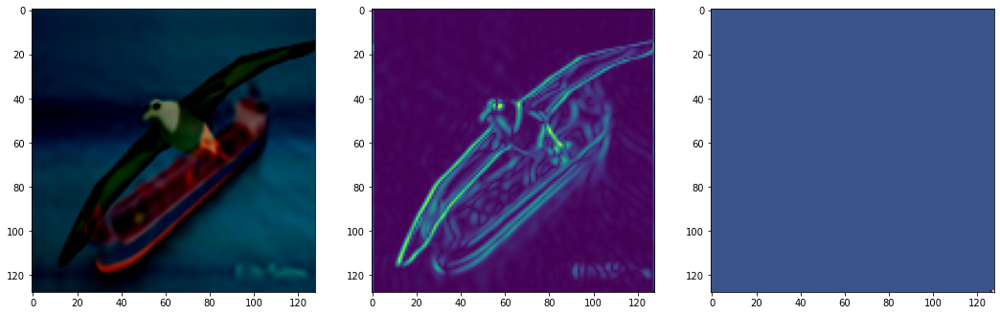

Step 309, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


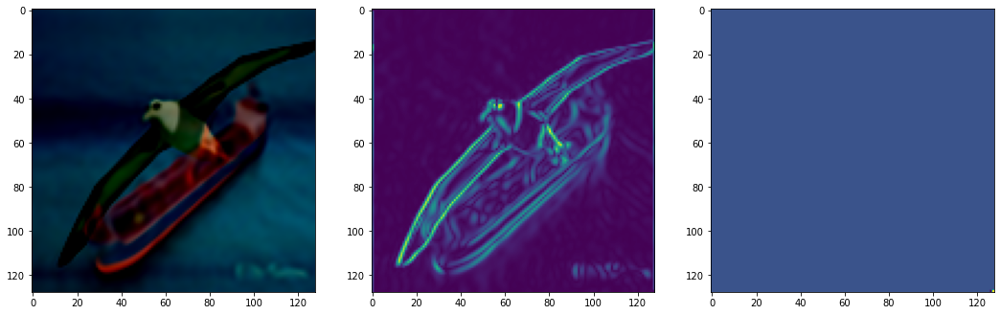

Step 319, Total loss 0.000003


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


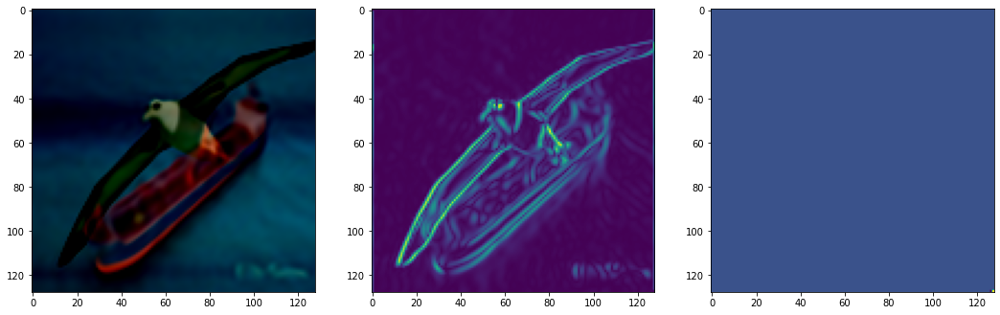

Step 329, Total loss 0.000003


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


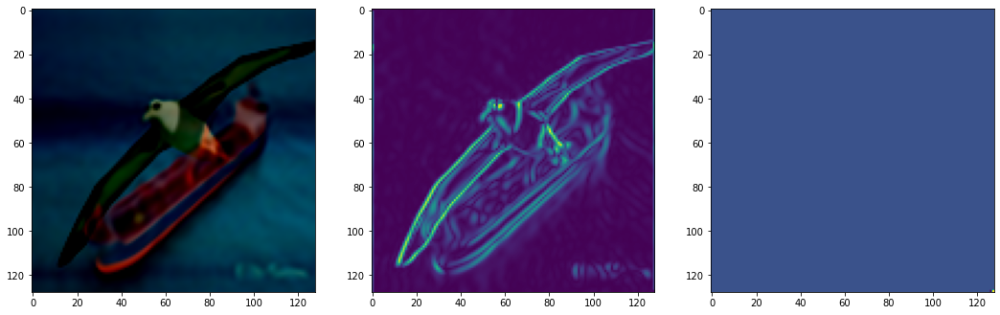

Step 339, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


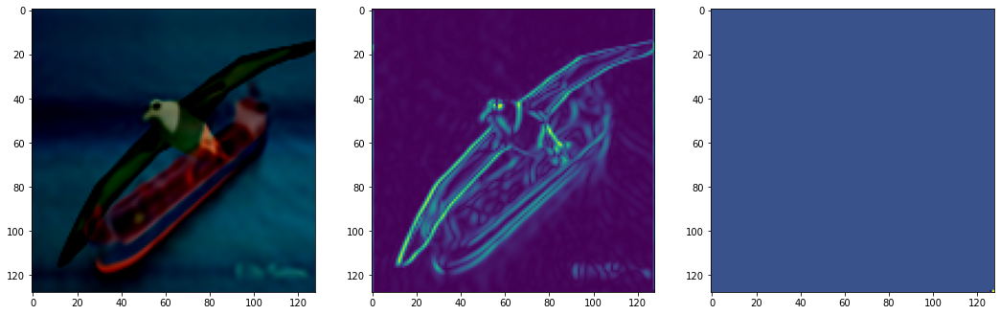

Step 349, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


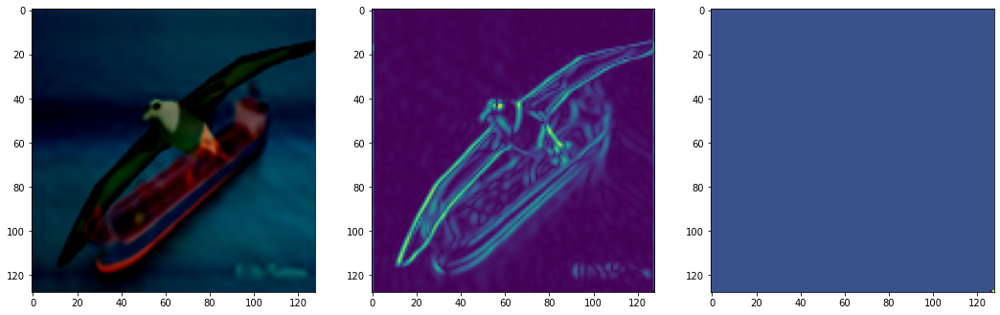

Step 359, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


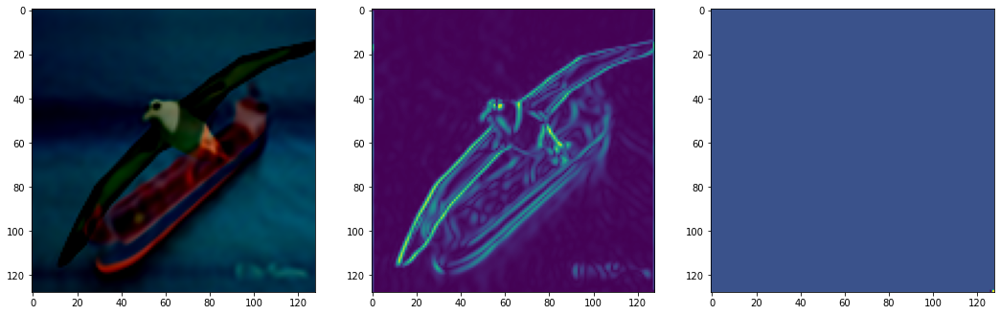

Step 369, Total loss 0.000000


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


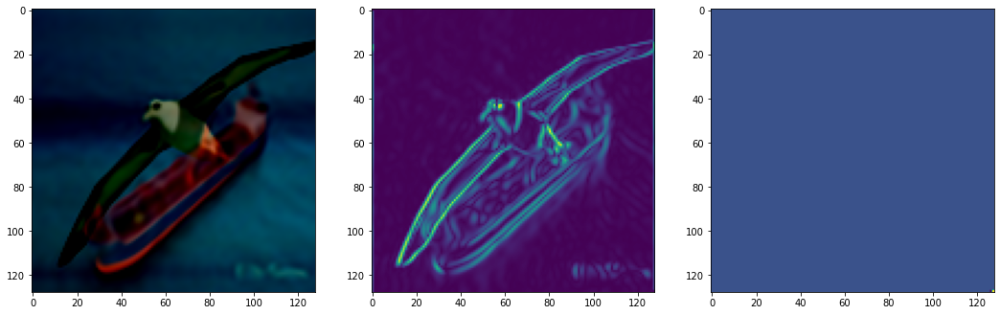

Step 379, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


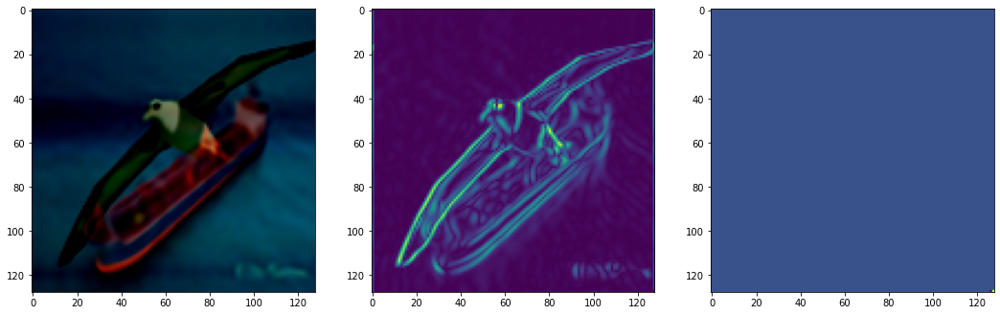

Step 389, Total loss 0.000007


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


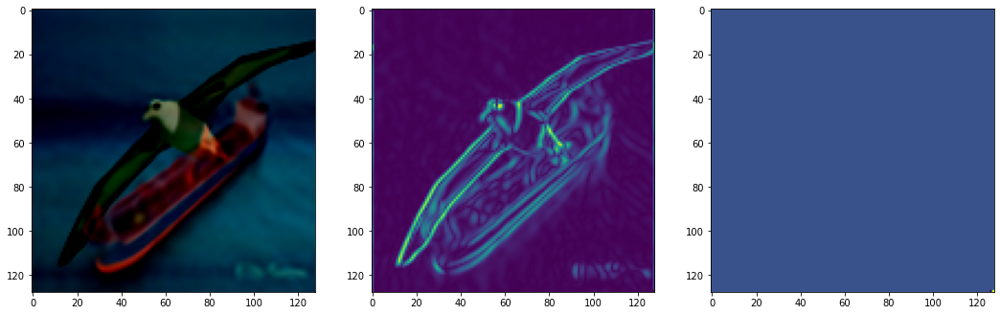

Step 399, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


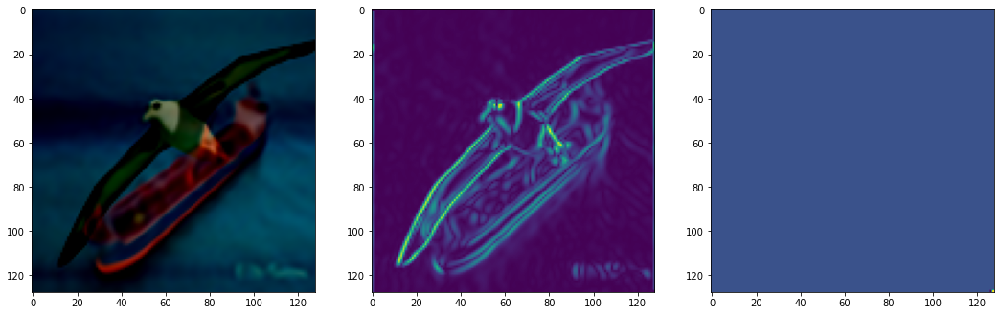

Step 409, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


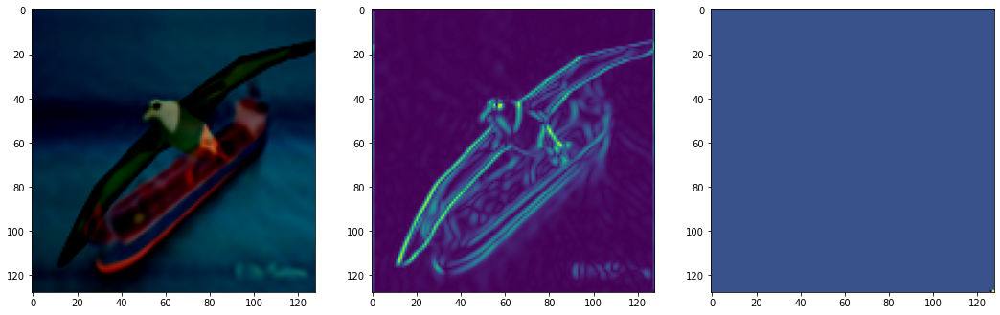

Step 419, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


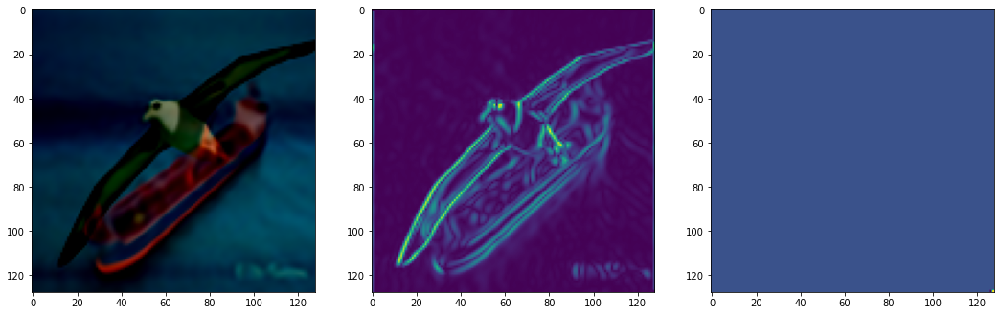

Step 429, Total loss 0.000000


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


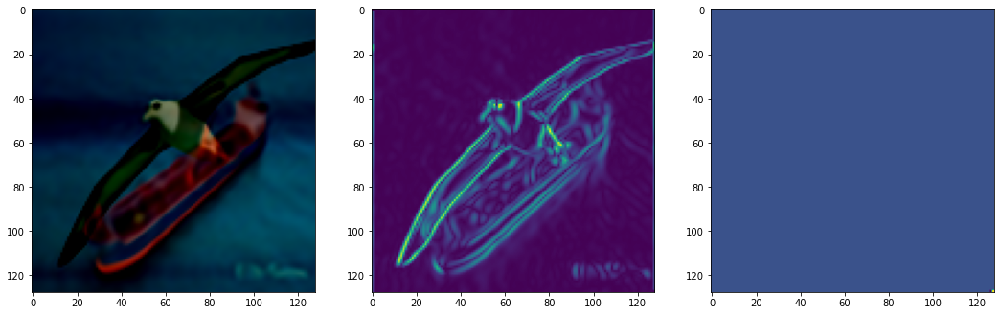

Step 439, Total loss 0.000000


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


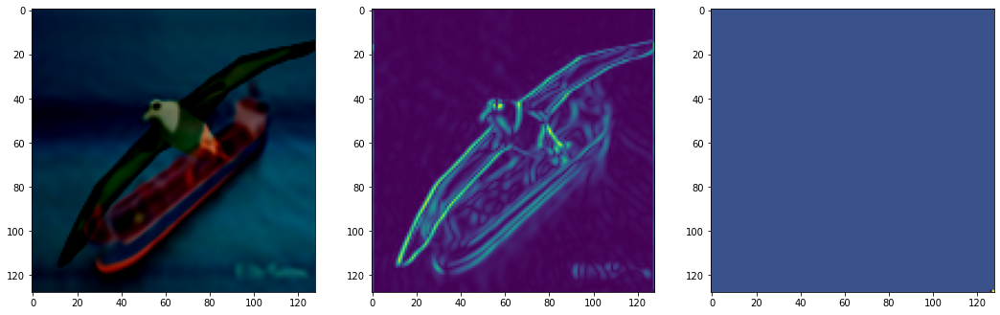

Step 449, Total loss 0.000006


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


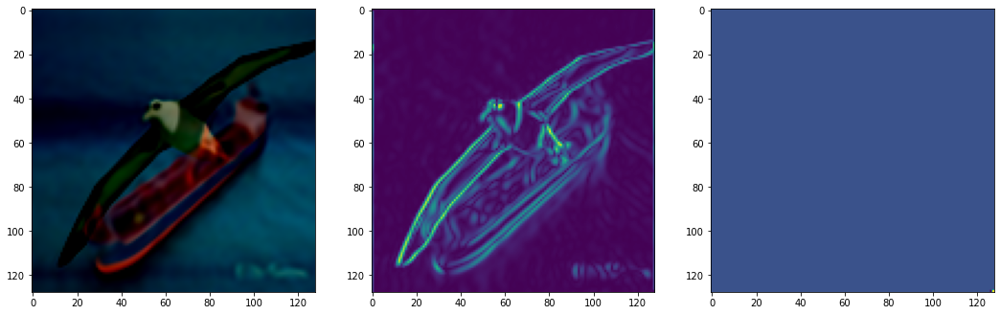

Step 459, Total loss 0.000003


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


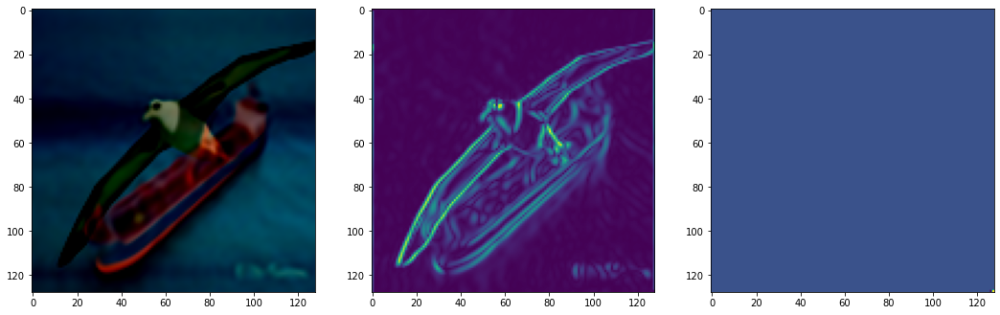

Step 469, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


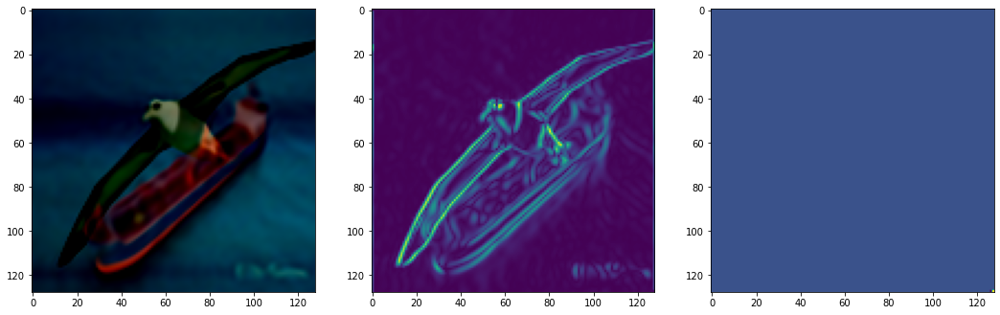

Step 479, Total loss 0.000000


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


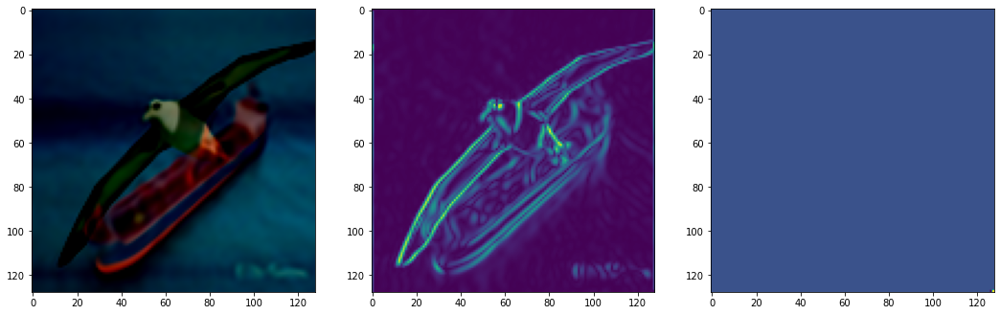

Step 489, Total loss 0.000000


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


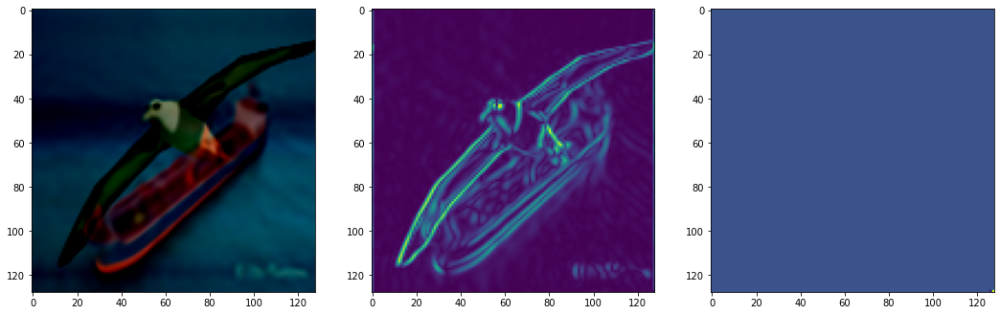

Step 499, Total loss 0.000001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Size image:  torch.Size([1, 1, 16384, 3])


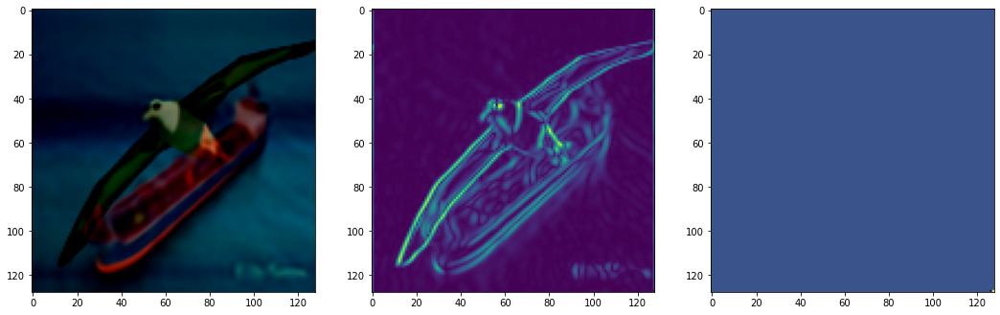

In [21]:
total_steps = 500 # Since the whole image is our dataset, this just means 500 gradient descent steps.
steps_til_summary = 10

optim = torch.optim.Adam(lr=1e-4, params=img_siren.parameters())

model_input, ground_truth = next(iter(dataloader1))
ground_truth=ground_truth.resize(1, 1, size_img**2, 3)
model_input, ground_truth = model_input.cuda(), ground_truth.cuda()
print("Input, output sizes; ", model_input.size(), ground_truth.size())
#print("Model_input: ", model_input[:3, :3])


#we determine the gradient
#model_input.requires_grad_()
#img_grad_truth=gradient(ground_truth, model_input)

for step in range(total_steps):
    
    model_output, coords = img_siren(model_input)
    #print("Output size: ", model_output.size())
    #print("Groundtruth size: ", ground_truth.size())
    
    model_output_2=gradient(model_output, coords)
    #print("Gradient output size: ", model_output_2.size())
    loss = ((model_output_2 - img_grad_aim)**2).mean()
    

    

    if not (step+1) % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        img_grad = gradient(model_output, coords)
        img_laplacian = laplace(model_output, coords)

        fig, axes = plt.subplots(1,3, figsize=(18,6))
        print("Size image: ", model_output.cpu().size())
        axes[0].imshow(model_output.cpu()[:, :1, :].view(size_img,size_img, 3).detach().numpy())
        axes[1].imshow(img_grad.norm(dim=-1).cpu()[:, :1].view(size_img,size_img).detach().numpy())
        axes[2].imshow(img_laplacian.cpu()[:, :1].view(size_img,size_img).detach().numpy())
        plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

In [18]:
sidelength=128
size_img=128
nb_images=1
imgA, imgB=get_images_pair(sidelength=sidelength)
img1 = ImageFitting1(size_img, imgA, nb_images=nb_images)
dataloader1 = DataLoader(img1, batch_size=1, pin_memory=True, num_workers=0)
model_input, ground_truth = next(iter(dataloader1))


Pixels size:  torch.Size([16384, 3])
torch.Size([128]) torch.Size([128]) torch.Size([1])
3
Mgrid step 2:  torch.Size([128, 128, 1, 3])
Mgrid step 3:  torch.Size([1, 16384, 3])
Coords size:  torch.Size([1, 16384, 3])


In [22]:
print(ground_truth.size())

torch.Size([1, 16384, 3])


In [21]:

grad_outputs = torch.ones_like(ground_truth)
grad = torch.autograd.grad(ground_truth, [model_input], grad_outputs=grad_outputs, create_graph=True)[0]

RuntimeError: ignored

In [ ]:
model_input, ground_truth = next(iter(dataloader1))
ground_truth=ground_truth.resize(1, 1, 3, size_img**2)